<font size = 6> Customer Churn Prediction for the Fitness Center </font> 

## Project Description

This project focuses on analyzing customer behavior in a fitness club to understand and reduce customer churn. Using historical customer data, the goal is to identify patterns and factors that lead to churn, predict the likelihood of individual customers leaving, and segment the customer base into meaningful groups. By combining predictive modeling, clustering, and feature analysis, the project aims to provide actionable insights and practical recommendations to help the business improve customer retention, tailor communication strategies, and enhance overall service quality.

<div class="text-justify">  Customer churn is a challenge faced by many companies, and fitness clubs are no exception. Data analytics can play a key role in helping businesses refine their customer engagement strategies by identifying the reasons behind churn and finding ways to reduce it. It’s especially important for companies to recognize early warning signs that a customer might be about to leave, since not all customers explicitly cancel their memberships or delete their accounts. These warning signs - also known as churn indicators — can vary across industries. For example, an online store might assume a customer is still active if they make regular purchases. But if that customer stops visiting the frequently updated website for more than two weeks, it may signal a risk of churn. In the fitness industry, a common indicator of churn is when a member hasn’t visited the gym in over a month. While in some cases this might mean the person is simply on vacation and plans to return, more often than not, it points to a loss of engagement and potential churn. </div>

A fitness club has compiled customer data with the goal of predicting user churn. The objective of this study is to analyze the data and develop actionable recommendations to help reduce customer attrition.

Research Objectives:

* Build a predictive model to estimate the probability of churn for each customer (on a monthly basis);
* Perform customer segmentation by clustering to identify typical customer profiles, highlight the most distinct groups, and describe their key characteristics;
* Analyze the most significant features that influence customer churn;
* Draw key conclusions and develop recommendations to improve customer retention, including:
    * Identifying target customer groups;
    * Proposing specific measures to reduce churn;
    * Defining other important aspects of customer interaction.

In [1]:
import pandas as pd
import datetime as dt
import numpy as np
import itertools
import requests
import re
import math
from io import BytesIO
import scipy.stats as stats
from statsmodels.stats.multitest import multipletests

import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.express as px
from plotly import graph_objects as go

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

from sklearn.preprocessing import StandardScaler
from scipy.cluster.hierarchy import dendrogram, linkage 
from sklearn.cluster import KMeans
#from clustergram import Clustergram
#import urbangrammar_graphics as ugg
from sklearn.preprocessing import scale
from sklearn.mixture import GaussianMixture
from sklearn.preprocessing import MinMaxScaler

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

pd.set_option('display.float_format', '{:,.2f}'.format) #настройки pandas для отображения чисел без лишних запятых
pd.set_option("max_colwidth", 200) #настройки pandas для отображения строк полностью

## Data Description

The fitness center provided the data in CSV files. The client prepared the dataset to include customer information from one month prior to potential churn, along with the actual churn status for a specific month.

In [2]:
try:
    # Try to load data from server
    data = pd.read_csv('/datasets/gym_churn.csv')
except:
    # If failed, load from local path
    data = pd.read_csv('D:/gym_churn.csv')    

In [3]:
data.head()

,gender,Near_Location,Partner,Promo_friends,Phone,Contract_period,Group_visits,Age,Avg_additional_charges_total,Month_to_end_contract,Lifetime,Avg_class_frequency_total,Avg_class_frequency_current_month,Churn
0,1,1,1,1,0,6,1,29,14.23,5.00,3,0.02,0.00,0
1,0,1,0,0,1,12,1,31,113.20,12.00,7,1.92,1.91,0
2,0,1,1,0,1,1,0,28,129.45,1.00,2,1.86,1.74,0
3,0,1,1,1,1,12,1,33,62.67,12.00,2,3.21,3.36,0
4,1,1,1,1,1,1,0,26,198.36,1.00,3,1.11,1.12,0


The dataset contains information about clients of a fitness club, aimed at analyzing and predicting customer churn. Each row represents an individual client, and the dataset includes both demographic and behavioral features. The main variables are:

**Feature Description**

**Customer Data (One Month Before Churn Assessment)**

| Feature                       | Description                                                                 |
|------------------------------|-----------------------------------------------------------------------------|
| `gender`                     | Customer's gender                                                          |
| `Near_Location`              | Whether the customer lives or works near the fitness center                |
| `Partner`                    | Customer works for a partner company (eligible for membership discounts)   |
| `Promo_friends`              | Signed up through a “Bring a Friend” promotion                             |
| `Phone`                      | Indicates whether a contact phone number is provided                       |
| `Age`                        | Customer's age                                                             |
| `Lifetime`                   | Number of months since first contact with the fitness center               |

**Behavioral Data and Subscription Information**

| Feature                          | Description                                                                 |
|----------------------------------|-----------------------------------------------------------------------------|
| `Contract_period`                | Duration of the current membership (1, 6, or 12 months)                    |
| `Month_to_end_contract`         | Months remaining until the membership contract expires                     |
| `Group_visits`                   | Indicates if the customer attends group classes                            |
| `Avg_class_frequency_total`      | Average weekly visits since the beginning of the membership                |
| `Avg_class_frequency_current_month` | Average weekly visits in the previous month                            |
| `Avg_additional_charges_total`   | Total spend on additional services (café, goods, spa, massage)             |
| `Churn`                          | Whether the customer churned in the current month (1 – churned, 0 – active) |

These features provide insight into customer engagement, contract characteristics, and demographic factors, enabling the development of predictive and segmentation models to reduce churn.

In [4]:
def to_snake_case(name):
    name = re.sub('(.)([A-Z][a-z]+)', r'\1_\2', name)
    name = re.sub('__([A-Z])', r'_\1', name)
    name = re.sub('([a-z0-9])([A-Z])', r'\1_\2', name)
    return name.lower()

In [5]:
def preprocess_data(data, snake_case):
    if snake_case == True:
        snake_case_columns = []
        for column in data.columns:
            snake_case_columns.append(to_snake_case(column))
        data.columns = snake_case_columns
    
    print('\033[1m' + 'Info:' + '\033[0m')
    data.info()
    
    print('\033[1m' + 'Head:' + '\033[0m')
    display(data.head())
    
    print('\033[1m' + 'Shape:' + '\033[0m')
    
    display(data.shape)
    #display('Number of dublicated values')
    
    print('\033[1m' + 'Number of dublicated values:' + '\033[0m')
    display(data.duplicated().sum())  

In [6]:
preprocess_data(data, True)

Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4000 entries, 0 to 3999
Data columns (total 14 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   gender                             4000 non-null   int64  
 1   near_location                      4000 non-null   int64  
 2   partner                            4000 non-null   int64  
 3   promo_friends                      4000 non-null   int64  
 4   phone                              4000 non-null   int64  
 5   contract_period                    4000 non-null   int64  
 6   group_visits                       4000 non-null   int64  
 7   age                                4000 non-null   int64  
 8   avg_additional_charges_total       4000 non-null   float64
 9   month_to_end_contract              4000 non-null   float64
 10  lifetime                           4000 non-null   int64  
 11  avg_class_frequency_total          4000 non-null  

,gender,near_location,partner,promo_friends,phone,contract_period,group_visits,age,avg_additional_charges_total,month_to_end_contract,lifetime,avg_class_frequency_total,avg_class_frequency_current_month,churn
0,1,1,1,1,0,6,1,29,14.23,5.00,3,0.02,0.00,0
1,0,1,0,0,1,12,1,31,113.20,12.00,7,1.92,1.91,0
2,0,1,1,0,1,1,0,28,129.45,1.00,2,1.86,1.74,0
3,0,1,1,1,1,12,1,33,62.67,12.00,2,3.21,3.36,0
4,1,1,1,1,1,1,0,26,198.36,1.00,3,1.11,1.12,0


Shape:


(4000, 14)

Number of dublicated values:


0

The dataset contains no missing values or duplicate records. The data types are correct and do not require any preliminary preprocessing.

## Exploratory Data Analysis (EDA)

### Descriptive Statistics of Features

Let us take a closer look at the descriptive statistics of the dataset used in this project.

In [7]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
gender,"4,000.00",0.51,0.50,0.00,0.00,1.00,1.00,1.00
near_location,"4,000.00",0.85,0.36,0.00,1.00,1.00,1.00,1.00
partner,"4,000.00",0.49,0.50,0.00,0.00,0.00,1.00,1.00
promo_friends,"4,000.00",0.31,0.46,0.00,0.00,0.00,1.00,1.00
phone,"4,000.00",0.90,0.30,0.00,1.00,1.00,1.00,1.00
contract_period,"4,000.00",4.68,4.55,1.00,1.00,1.00,6.00,12.00
group_visits,"4,000.00",0.41,0.49,0.00,0.00,0.00,1.00,1.00
age,"4,000.00",29.18,3.26,18.00,27.00,29.00,31.00,41.00
avg_additional_charges_total,"4,000.00",146.94,96.36,0.15,68.87,136.22,210.95,552.59
month_to_end_contract,"4,000.00",4.32,4.19,1.00,1.00,1.00,6.00,12.00


The descriptive statistics reveal a roughly equal gender split among customers. A significant majority—about 85%—live or work near the fitness center. Nearly half of the clients are employed by partner companies, and 31% joined through the “Bring a Friend” promotion. Contact phone numbers are provided by 90% of customers. On average, customers have been with the club for 3.72 months.

The average membership duration is 4.68 months, with 4.32 months remaining until the end of the current contract. Approximately 41% of clients participate in group classes. The average weekly visit frequency over the entire membership period is 1.88, compared to 1.77 in the most recent month. Customers spend an average of 146.94 on additional services such as the café, shop, spa, or massage, with spending ranging from 0.15 to 552.59. Overall, the churn rate in the dataset is 27%.

In [8]:
data.query('churn == 0').describe().T

,count,mean,std,min,25%,50%,75%,max
gender,"2,939.00",0.51,0.50,0.00,0.00,1.00,1.00,1.00
near_location,"2,939.00",0.87,0.33,0.00,1.00,1.00,1.00,1.00
partner,"2,939.00",0.53,0.50,0.00,0.00,1.00,1.00,1.00
promo_friends,"2,939.00",0.35,0.48,0.00,0.00,0.00,1.00,1.00
phone,"2,939.00",0.90,0.30,0.00,1.00,1.00,1.00,1.00
contract_period,"2,939.00",5.75,4.72,1.00,1.00,6.00,12.00,12.00
group_visits,"2,939.00",0.46,0.50,0.00,0.00,0.00,1.00,1.00
age,"2,939.00",29.98,3.01,19.00,28.00,30.00,32.00,41.00
avg_additional_charges_total,"2,939.00",158.45,99.80,0.17,76.92,149.88,224.45,552.59
month_to_end_contract,"2,939.00",5.28,4.36,1.00,1.00,6.00,10.00,12.00


In [9]:
data.query('churn == 1').describe().T

,count,mean,std,min,25%,50%,75%,max
gender,"1,061.00",0.51,0.50,0.00,0.00,1.00,1.00,1.00
near_location,"1,061.00",0.77,0.42,0.00,1.00,1.00,1.00,1.00
partner,"1,061.00",0.36,0.48,0.00,0.00,0.00,1.00,1.00
promo_friends,"1,061.00",0.18,0.39,0.00,0.00,0.00,0.00,1.00
phone,"1,061.00",0.90,0.30,0.00,1.00,1.00,1.00,1.00
contract_period,"1,061.00",1.73,2.13,1.00,1.00,1.00,1.00,12.00
group_visits,"1,061.00",0.27,0.44,0.00,0.00,0.00,1.00,1.00
age,"1,061.00",26.99,2.90,18.00,25.00,27.00,29.00,38.00
avg_additional_charges_total,"1,061.00",115.08,77.70,0.15,50.63,103.81,165.62,425.54
month_to_end_contract,"1,061.00",1.66,1.96,1.00,1.00,1.00,1.00,12.00


The number of churned customers is lower than the number of those who stayed. Overall, churned clients tend to live or work farther from the fitness center, have shorter membership durations, attend fewer group classes, and visit the center less frequently—both in the past month and over the entire membership period.

### Analysis of Feature Means by Churn Status

Let’s group the data by the churn column to examine the average values of key features for churned and retained customers.

In [10]:
data_by_churn = data.groupby('churn').agg('mean')
data_by_churn.T

churn,0,1
gender,0.51,0.51
near_location,0.87,0.77
partner,0.53,0.36
promo_friends,0.35,0.18
phone,0.90,0.90
contract_period,5.75,1.73
group_visits,0.46,0.27
age,29.98,26.99
avg_additional_charges_total,158.45,115.08
month_to_end_contract,5.28,1.66


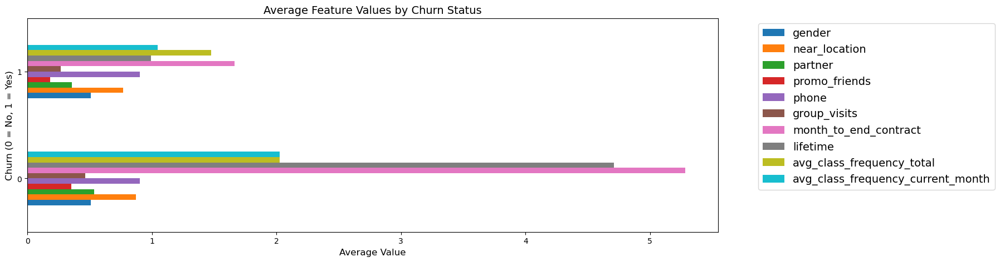

In [11]:
data_by_churn.drop(['avg_additional_charges_total', 'age', 'contract_period'], axis=1).plot(
    kind='barh', figsize=(16, 5)
)

plt.title('Average Feature Values by Churn Status', fontsize=14)
plt.xlabel('Average Value', fontsize=12)
plt.ylabel('Churn (0 = No, 1 = Yes)', fontsize=12)
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left', fontsize=14)
plt.show()

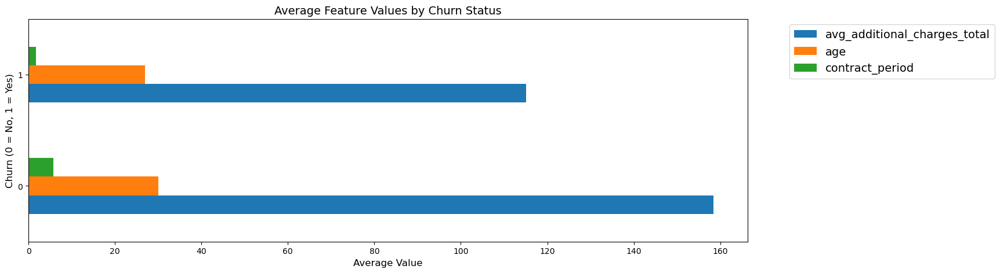

In [12]:
data_by_churn[['avg_additional_charges_total', 'age', 'contract_period']].plot(
    kind='barh', figsize=(16, 5)
)

plt.title('Average Feature Values by Churn Status', fontsize=14)
plt.xlabel('Average Value', fontsize=12)
plt.ylabel('Churn (0 = No, 1 = Yes)', fontsize=12)
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left', fontsize=14)
plt.show()

The analysis shows that some features have little to no influence on customer churn, while others reveal clear behavioral and contractual patterns. Gender and the presence of a phone number do not appear to affect whether a customer leaves. Age has a slight impact: customers who stayed with the fitness center are slightly older on average (29.98 years) compared to those who churned (26.99 years).

However, several variables show meaningful differences between the two groups. Customers who live or work near the gym are less likely to churn, suggesting that proximity plays a role in long-term engagement. Similarly, those employed by partner companies tend to be more loyal, likely due to benefits such as corporate discounts. Customers who joined through the “Bring a Friend” promotion also show lower churn rates, possibly indicating stronger initial motivation or peer encouragement.

Contract-related factors are among the most influential. Clients who did not churn typically held longer memberships, with an average contract duration of 5.75 months compared to just 1.73 months for those who left. They also had more time remaining on their contracts—5.28 months versus 1.66—at the point of analysis. Lifetime value is another differentiator: retained customers had been with the gym for an average of 4.71 months, while those who churned averaged only 0.99 months.

Customer engagement is clearly linked to retention. Regular participation in group classes was more common among those who stayed (46%) than among those who left (27%). Spending on additional services such as the café, shop, or spa also differed, with retained clients spending significantly more on average—158.45 compared to 115.08. Visit frequency followed the same pattern: customers who stayed visited the gym 2.02 times per week on average over their full membership, while churned customers averaged 1.47. In the most recent month, the difference was even more striking: 2.03 versus 1.04 visits per week.

Together, these findings highlight clear trends in customer behavior and provide a strong foundation for developing targeted churn prevention strategies.

### Feature Distributions by Churn Status

To better understand how different features behave for churned and retained customers, we plotted histograms and distribution plots for both groups. This allows us to visually compare key characteristics and identify patterns that may contribute to customer churn.

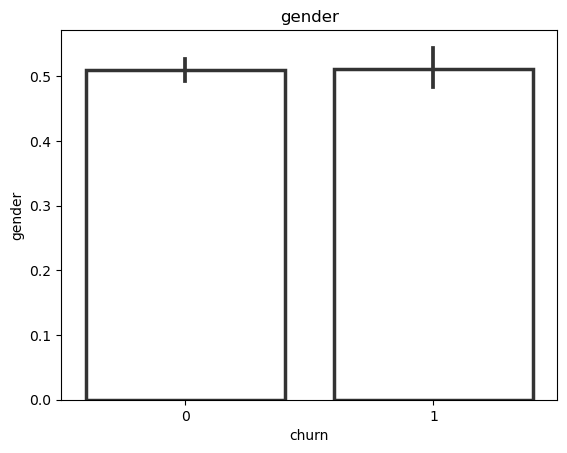

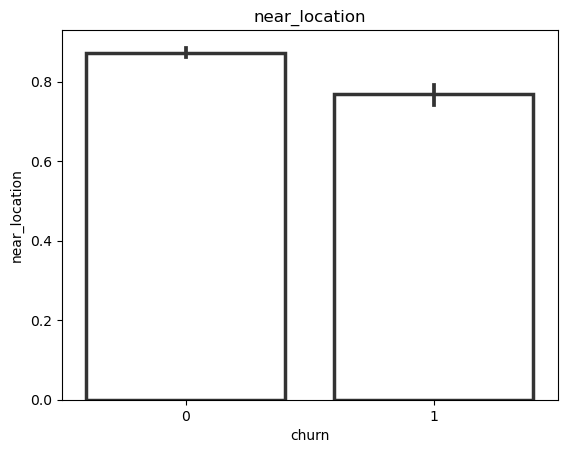

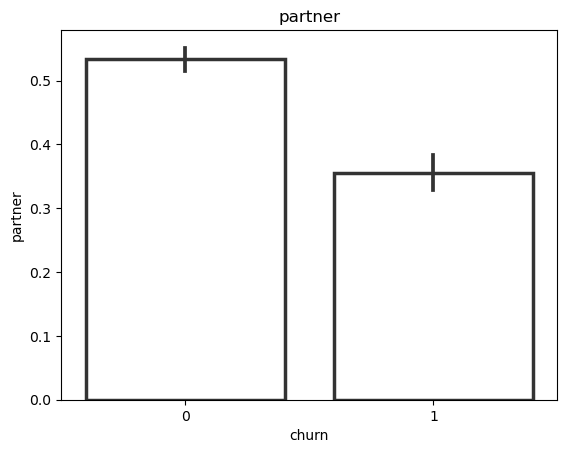

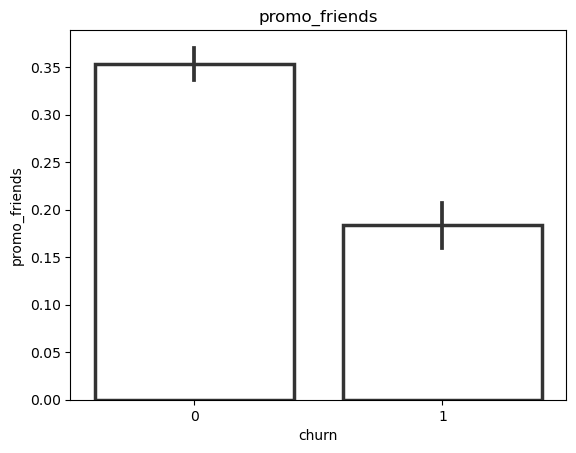

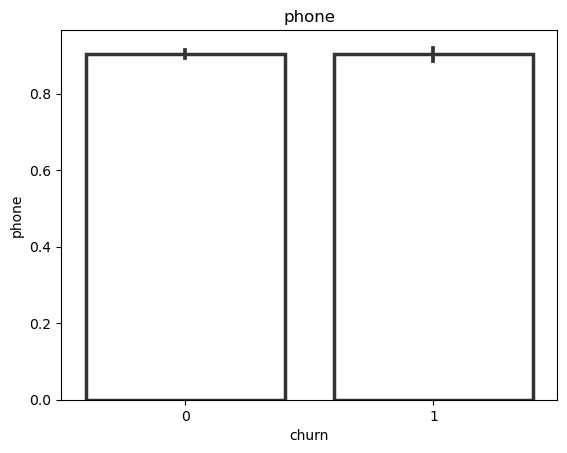

...

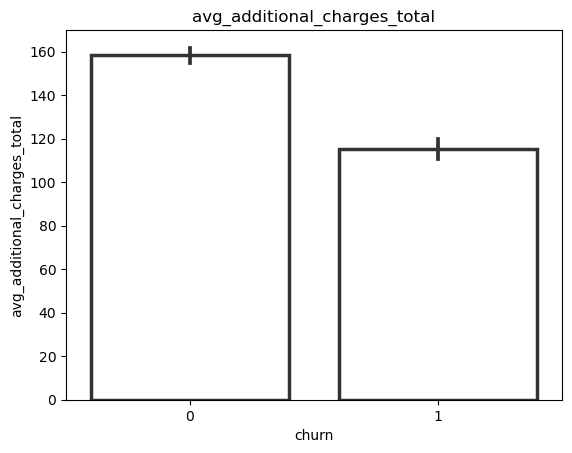

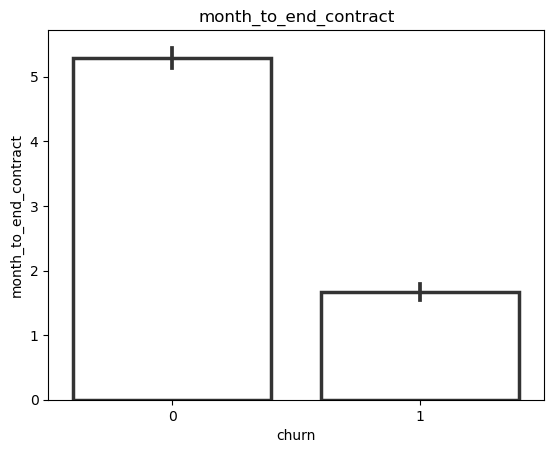

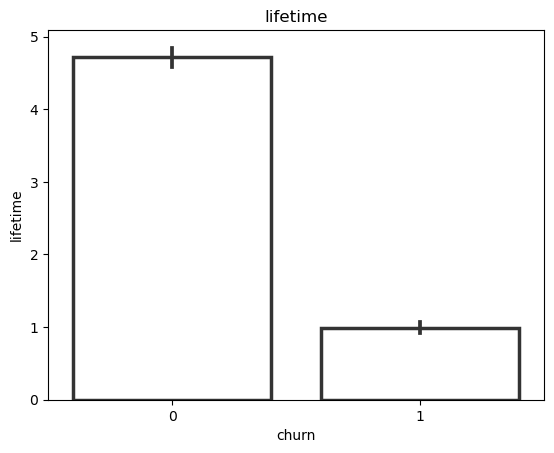

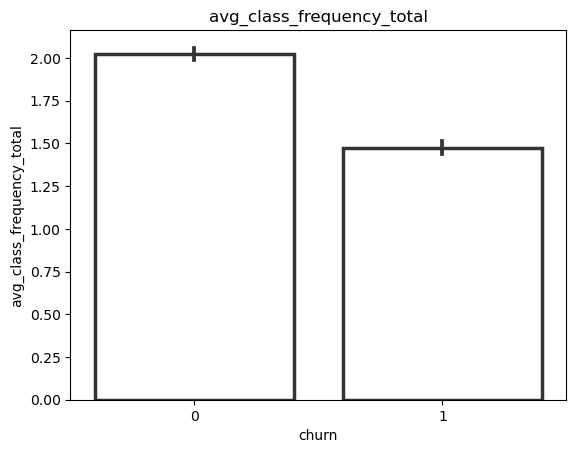

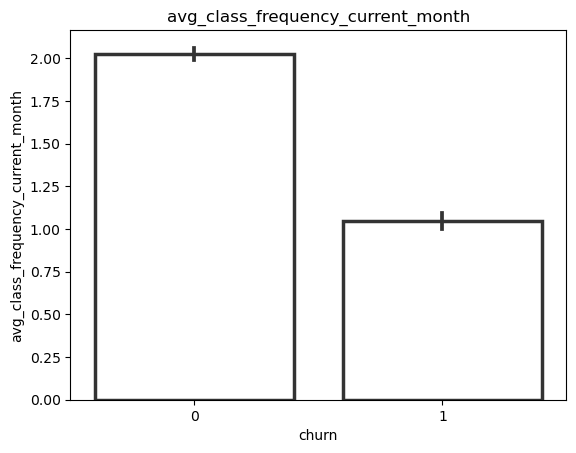

In [13]:
for col in data.columns[:-1]:
    sns.barplot(x='churn', y=col, data=data,
               linewidth=2.5, facecolor=(1, 1, 1, 0),
                 errcolor=".2", edgecolor=".2"
               )
            
    plt.title(col)
    plt.show()

The bar charts clearly illustrate the previously observed differences between customers who churned and those who remained with the fitness club.

In [14]:
def plot_dist(column):
    ax = sns.displot(data=data,
                     x=column, 
                     kind="kde", 
                     height=6,
                     aspect=2,
                     hue="churn",
                     #multiple="stack",
                     fill = True
                    )

    #ax.set_xticklabels(rotation = 30)
    plt.title(f"Distribution histogram of {column.name}")
   
    plt.show()

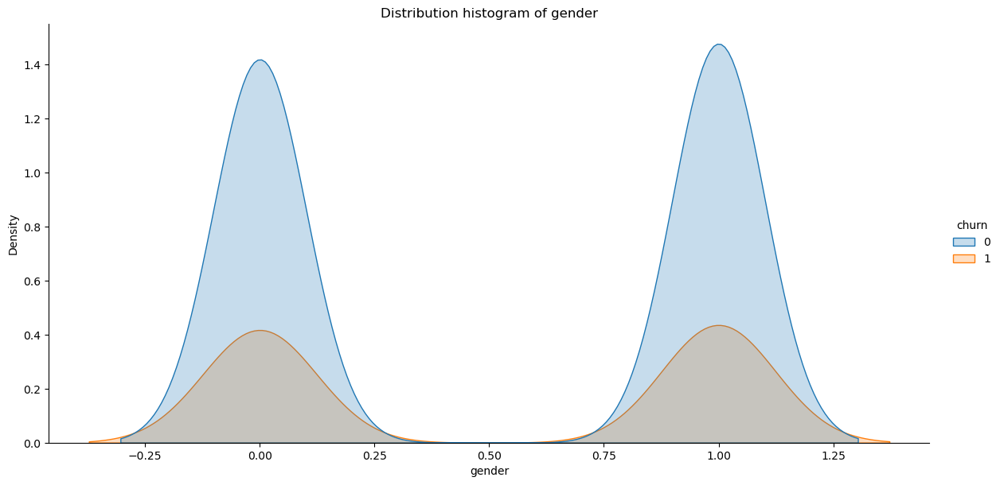

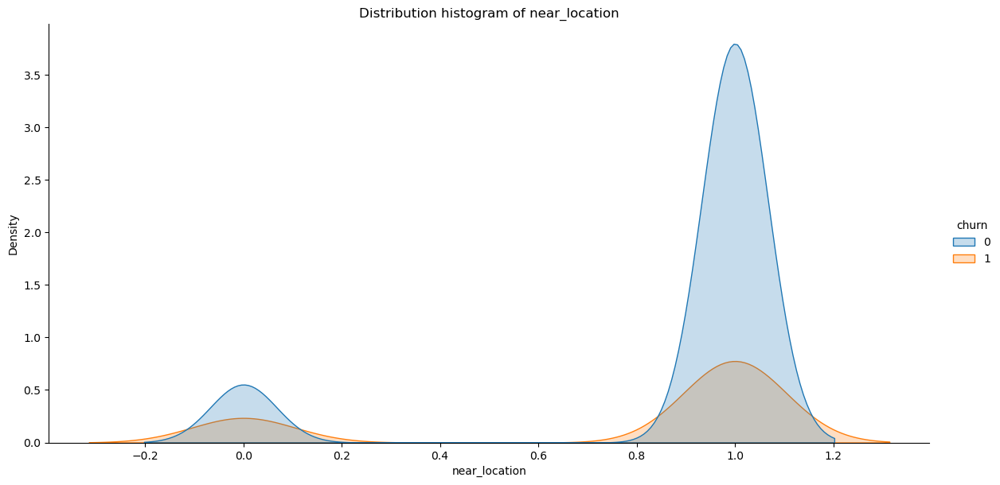

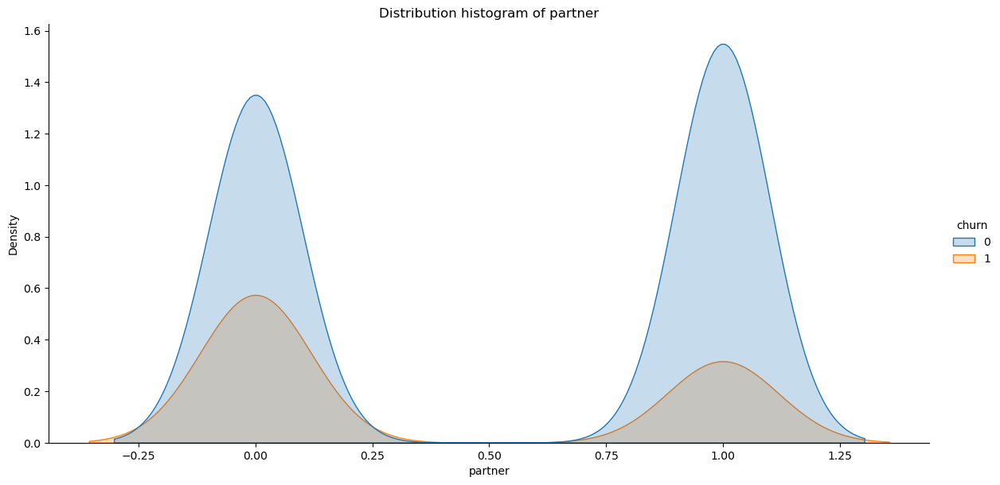

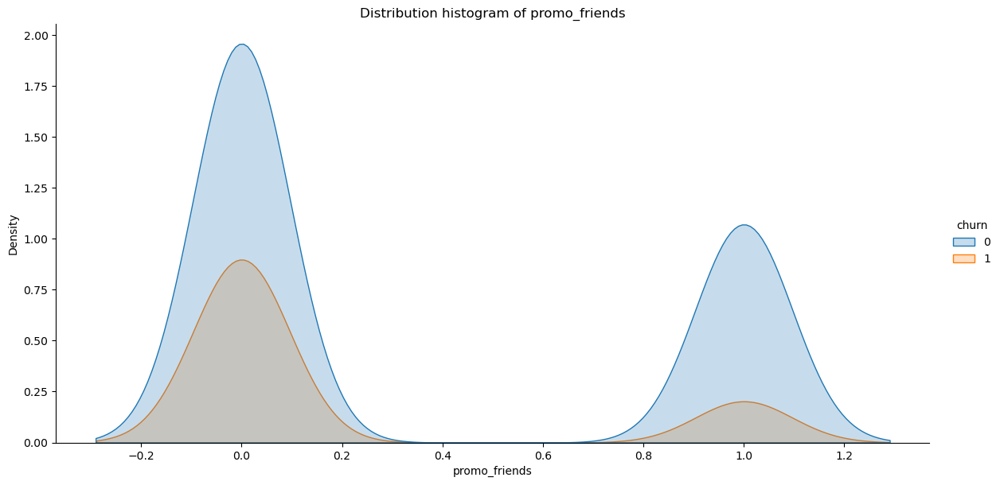

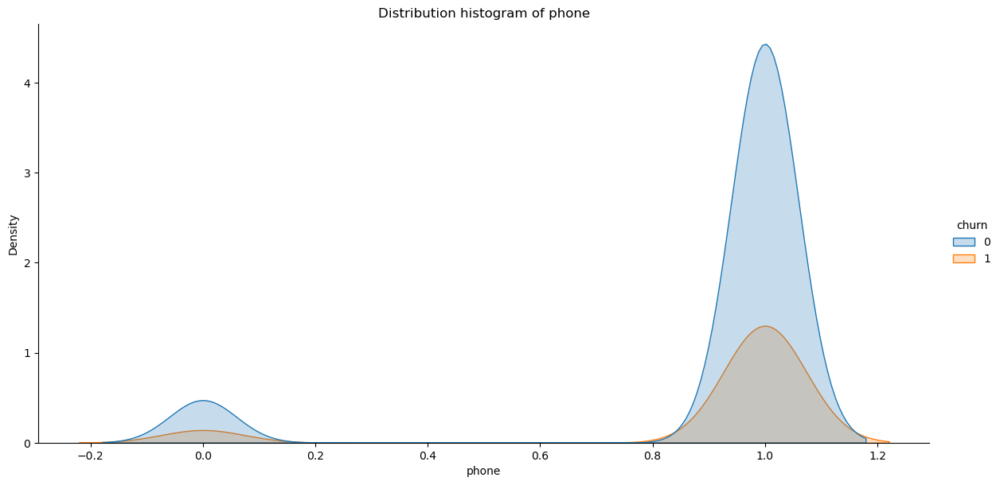

...

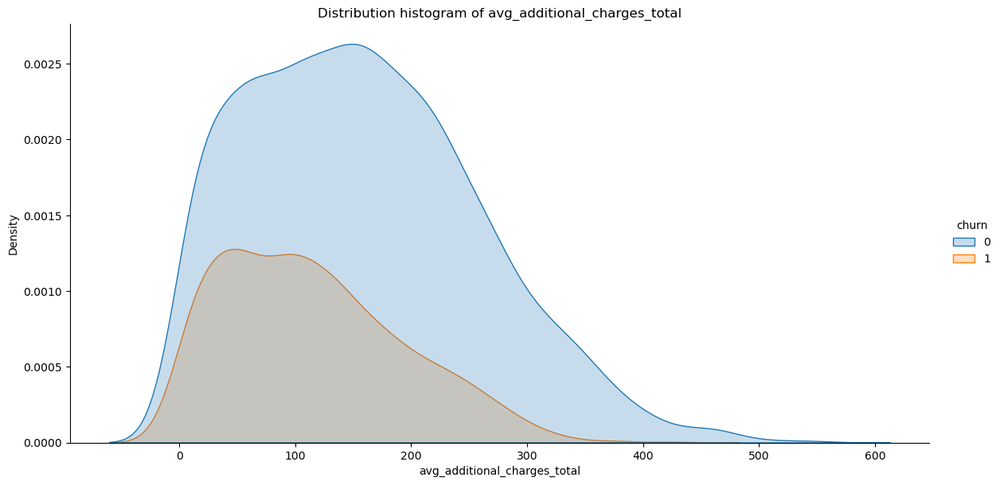

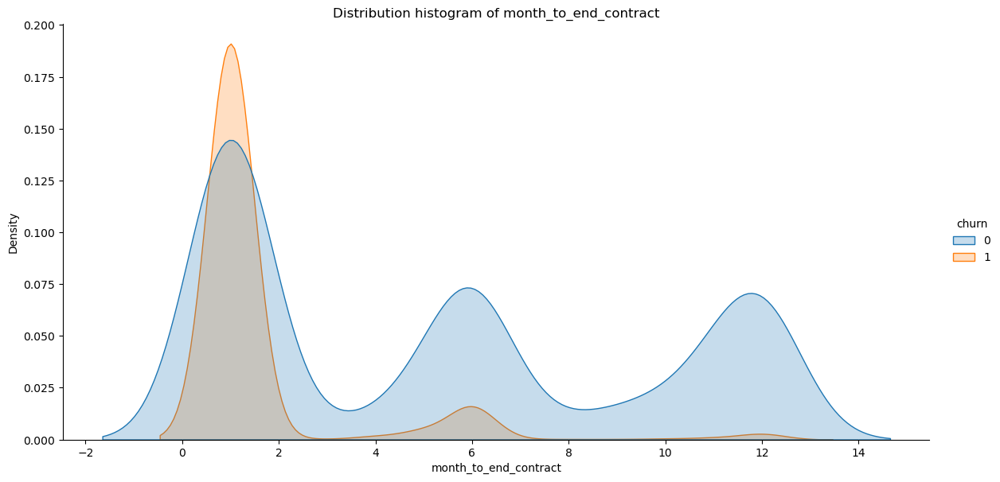

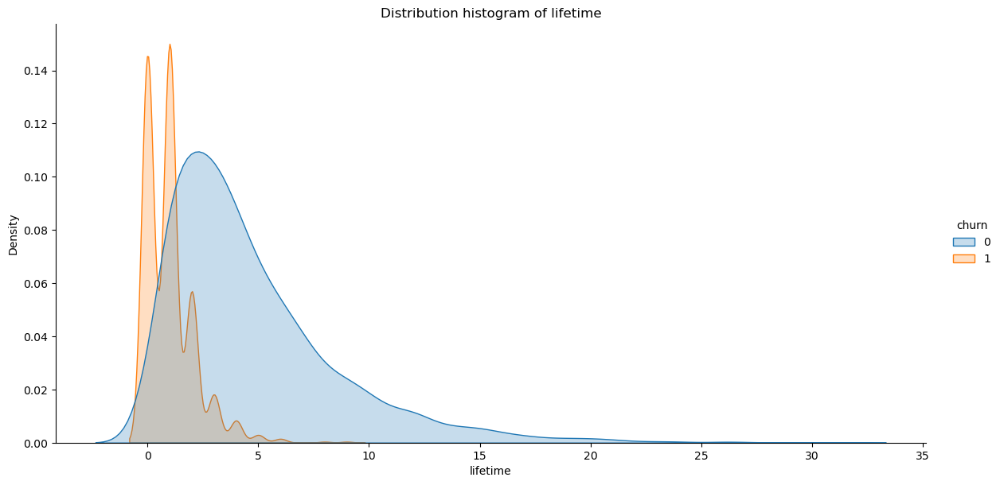

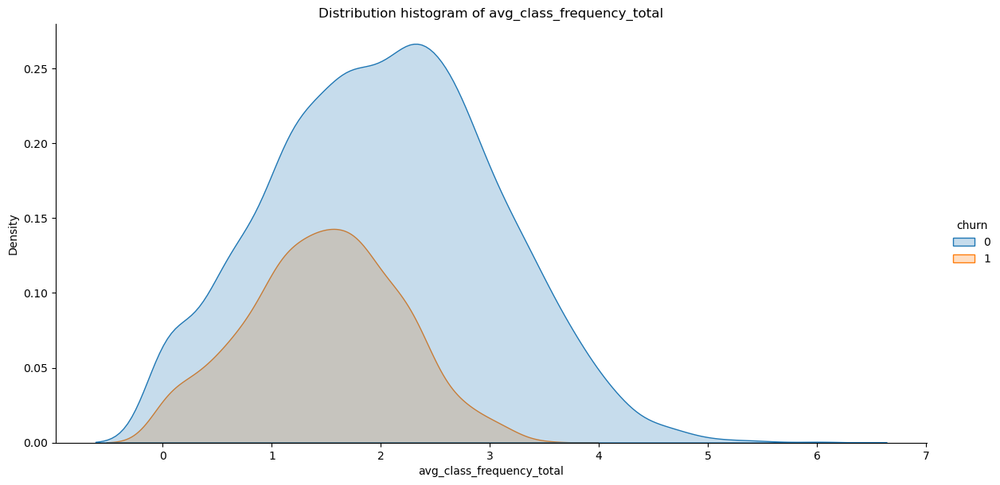

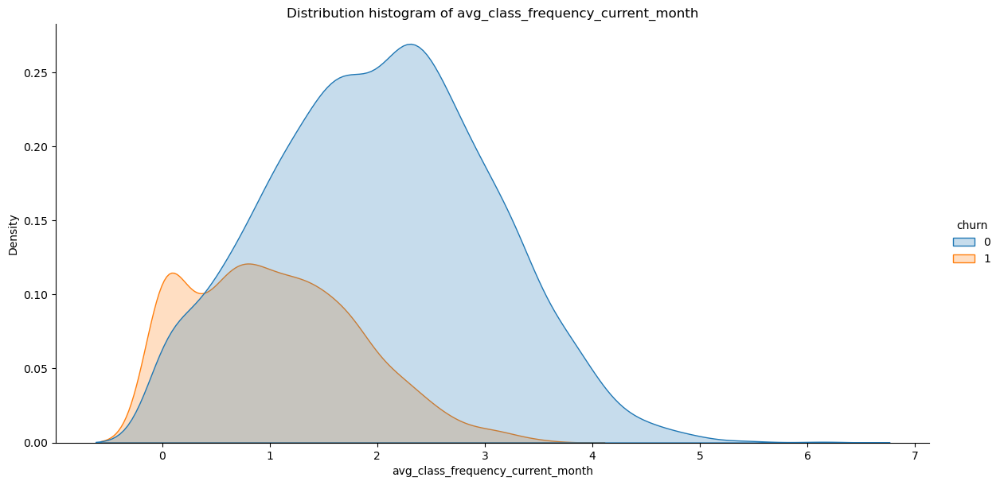

In [15]:
for col in data.columns[:-1]:
    plot_dist(data[col])

The histograms clearly highlight the differences in key metrics between customers who churned and those who stayed.

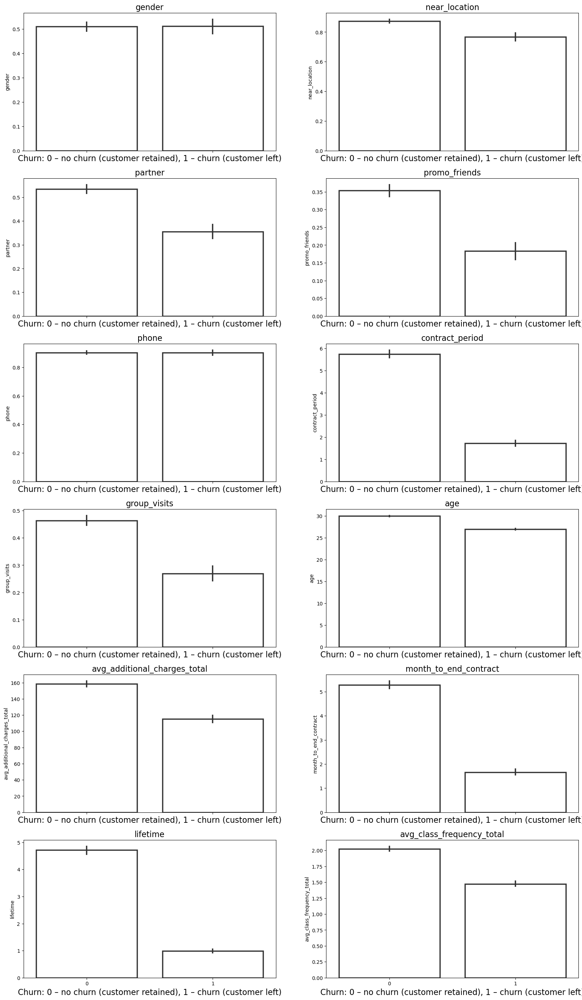

In [16]:
#define plotting region (number of rows, number of columns)
fig, axes = plt.subplots(6, 2, figsize=(20,35), sharex=True)

#create plot in each subplot
for index, column in enumerate(data.columns[:-2]):
    row = index // 2
    col = index % 2
    ax = sns.barplot(data=data, x='churn', y=column, ax=axes[row, col],
                     linewidth=2.5, facecolor=(1, 1, 1, 0),
                     errcolor=".2", edgecolor=".2")
    ax.set_title(column, fontsize=16)
    ax.set_xlabel('Churn: 0 – no churn (customer retained), 1 – churn (customer left)', fontsize=16)
plt.show()

Let’s take a closer look at how each feature influences customer churn.

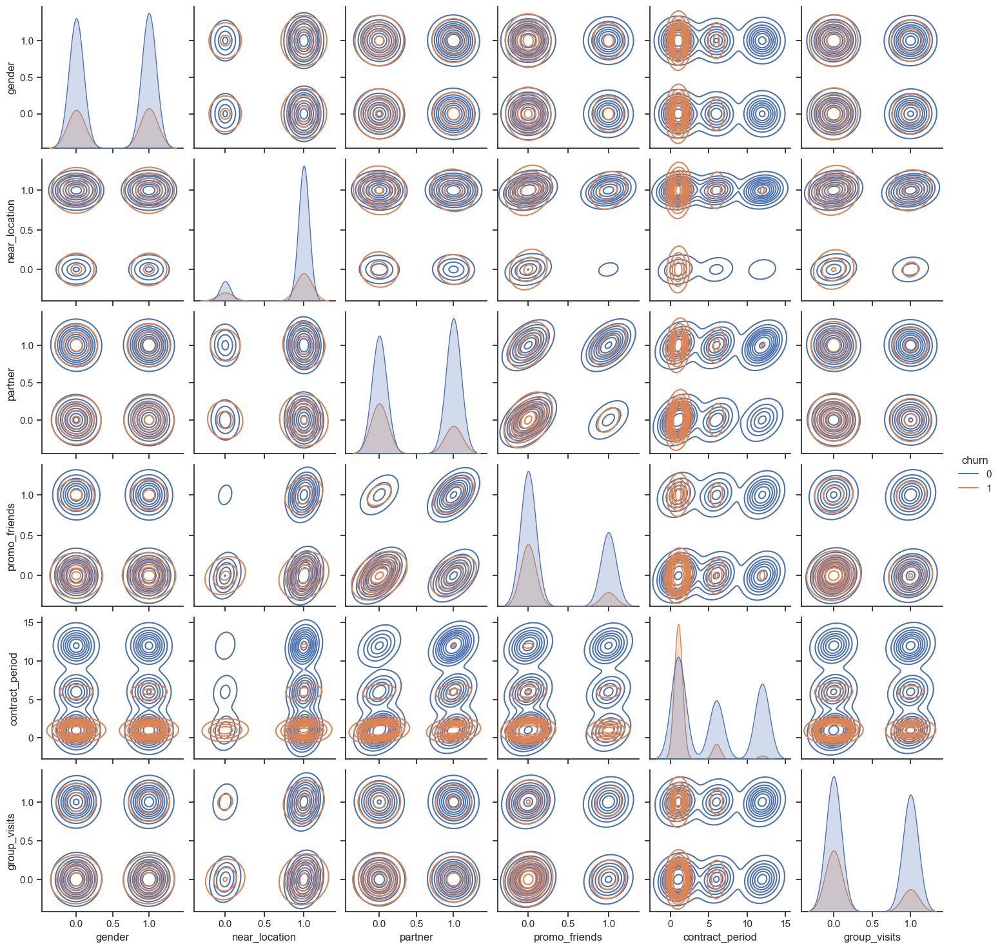

In [17]:
sns.set_theme(style="ticks")
sns.pairplot(data[['gender', 'near_location', 'partner', 'promo_friends', 'contract_period',  'group_visits', 'churn']], hue="churn",kind="kde")
plt.show()

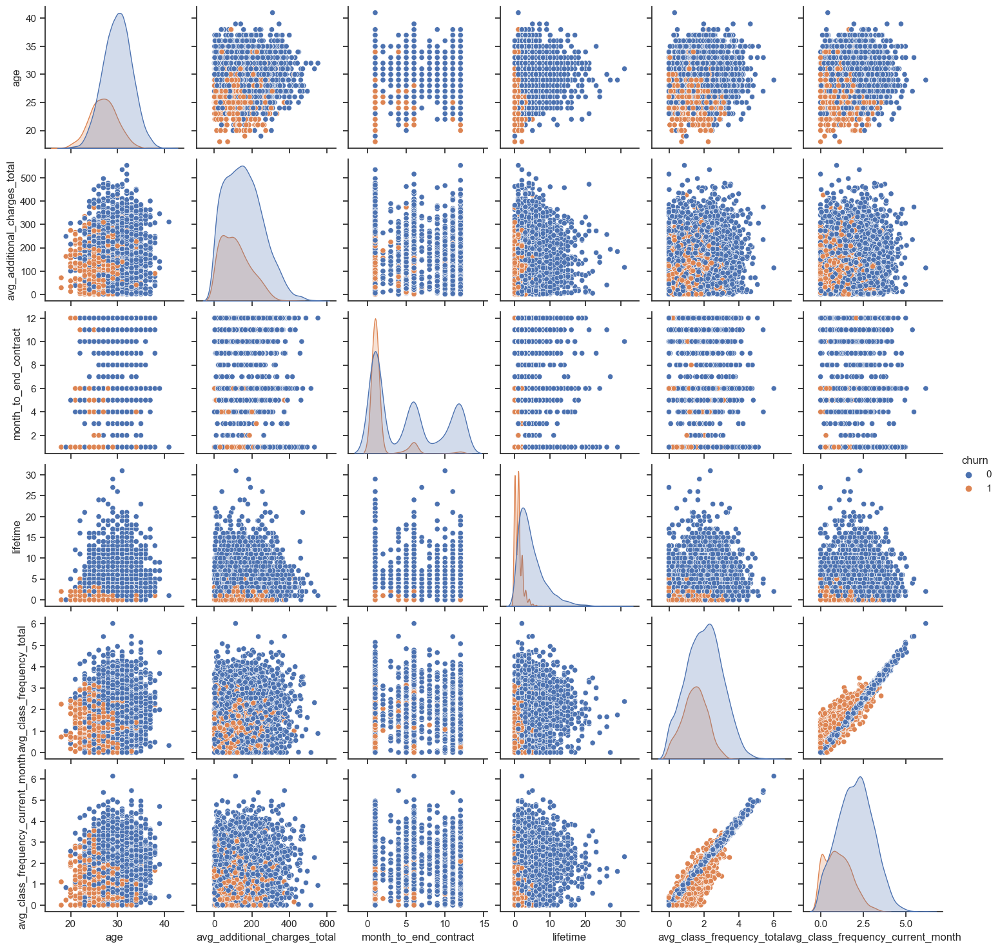

In [18]:
sns.set_theme(style="ticks")
sns.pairplot(data[['age', 'avg_additional_charges_total', 'month_to_end_contract', 'lifetime',
       'avg_class_frequency_total', 'avg_class_frequency_current_month', 'churn']], hue="churn")
plt.show()

The chart shows that younger customers are more likely to churn. It also highlights that churned clients generate less additional revenue and tend to purchase shorter-term memberships, rarely opting for long-term plans. Additionally, the churn group exhibits significantly lower visit frequency compared to those who remained.

### Correlation Matrix

Let’s build a correlation matrix to identify relationships between the features.

In [19]:
corr_m = data.corr()

In [20]:
corr_m

,gender,near_location,partner,promo_friends,phone,contract_period,group_visits,age,avg_additional_charges_total,month_to_end_contract,lifetime,avg_class_frequency_total,avg_class_frequency_current_month,churn
gender,1.00,0.01,-0.01,-0.01,-0.01,0.00,0.02,0.01,-0.01,-0.00,0.01,0.01,0.01,0.00
near_location,0.01,1.00,-0.01,0.21,-0.02,0.15,0.15,0.06,0.04,0.14,0.07,0.04,0.06,-0.13
partner,-0.01,-0.01,1.00,0.45,0.01,0.31,0.02,0.05,0.02,0.29,0.06,0.02,0.05,-0.16
promo_friends,-0.01,0.21,0.45,1.00,0.00,0.24,0.12,0.05,0.04,0.24,0.07,0.03,0.05,-0.16
phone,-0.01,-0.02,0.01,0.00,1.00,-0.01,-0.01,-0.01,0.01,-0.01,-0.02,0.01,0.01,-0.00
contract_period,0.00,0.15,0.31,0.24,-0.01,1.00,0.17,0.14,0.11,0.97,0.17,0.10,0.16,-0.39
group_visits,0.02,0.15,0.02,0.12,-0.01,0.17,1.00,0.08,0.03,0.16,0.08,0.06,0.08,-0.18
age,0.01,0.06,0.05,0.05,-0.01,0.14,0.08,1.00,0.08,0.13,0.16,0.12,0.18,-0.40
avg_additional_charges_total,-0.01,0.04,0.02,0.04,0.01,0.11,0.03,0.08,1.00,0.11,0.08,0.04,0.08,-0.20
month_to_end_contract,-0.00,0.14,0.29,0.24,-0.01,0.97,0.16,0.13,0.11,1.00,0.16,0.09,0.15,-0.38


We will visualize the data using a heatmap to better understand the correlations between features.

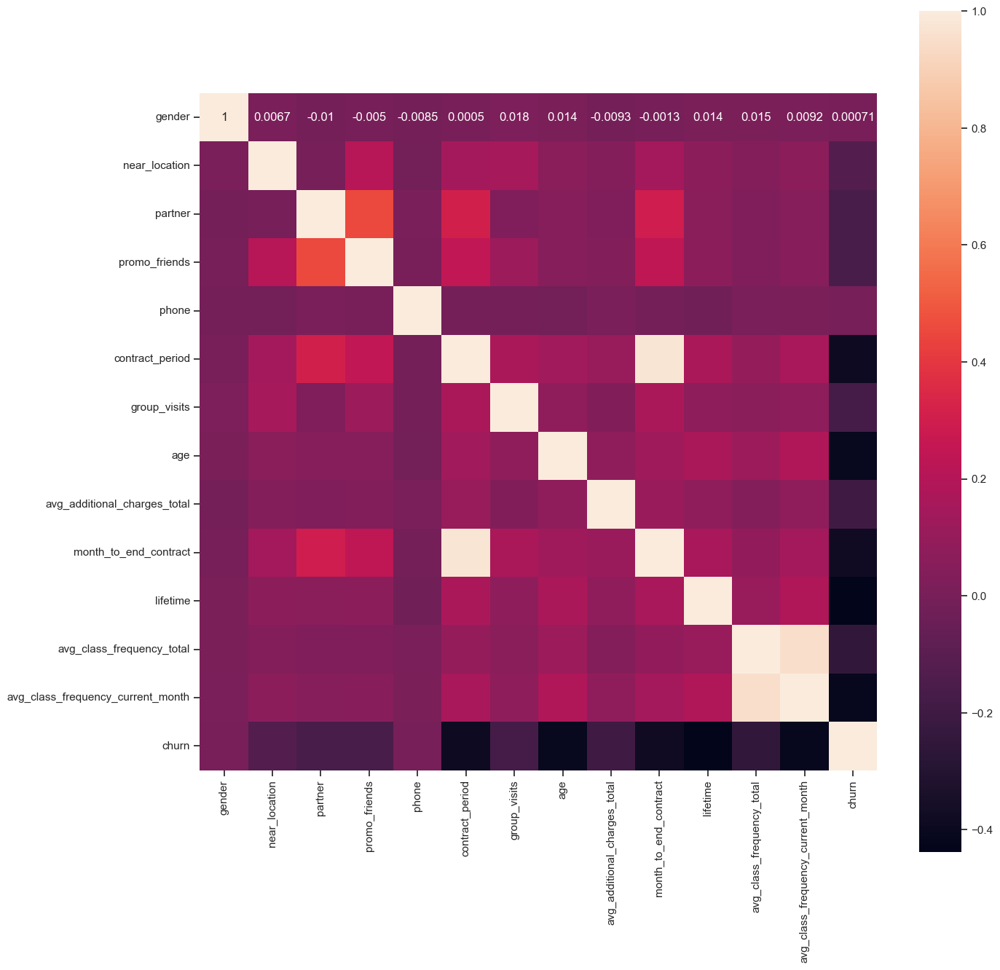

In [21]:
plt.figure(figsize = (15,15))
sns.heatmap(corr_m, 
        square = True, 
        annot = True)
plt.show()

Let’s take a closer look at the features that have the strongest influence on customer churn. The variables promo_friends and partner show similar correlation values with churn, suggesting potential multicollinearity between them.

In [22]:
data = data.drop('partner', axis = 1)

We created a horizontal bar chart to highlight the features most strongly correlated with customer churn. The plot displays the absolute strength of the relationship between each feature and the target variable, excluding churn itself.

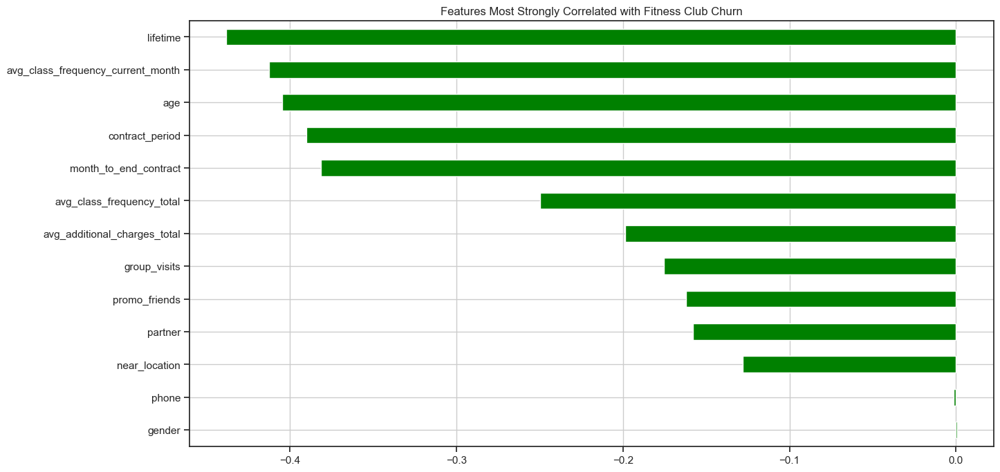

In [23]:
plt.figure(figsize=(15, 8))
corr_m.sort_values(by='churn', ascending=False)['churn'][1:].plot(
    kind='barh', color='green', grid=True
)
plt.title('Features Most Strongly Correlated with Fitness Club Churn')
plt.show()

The data shows that the strongest factors influencing customer churn are lifetime, visit frequency in the last month, age, contract duration, and the number of months remaining on the membership. In contrast, features like gender and whether a phone number was provided have almost no correlation with churn and appear to have little to no impact.

Let’s visualize the most influential features using a pairplot from the Seaborn library.

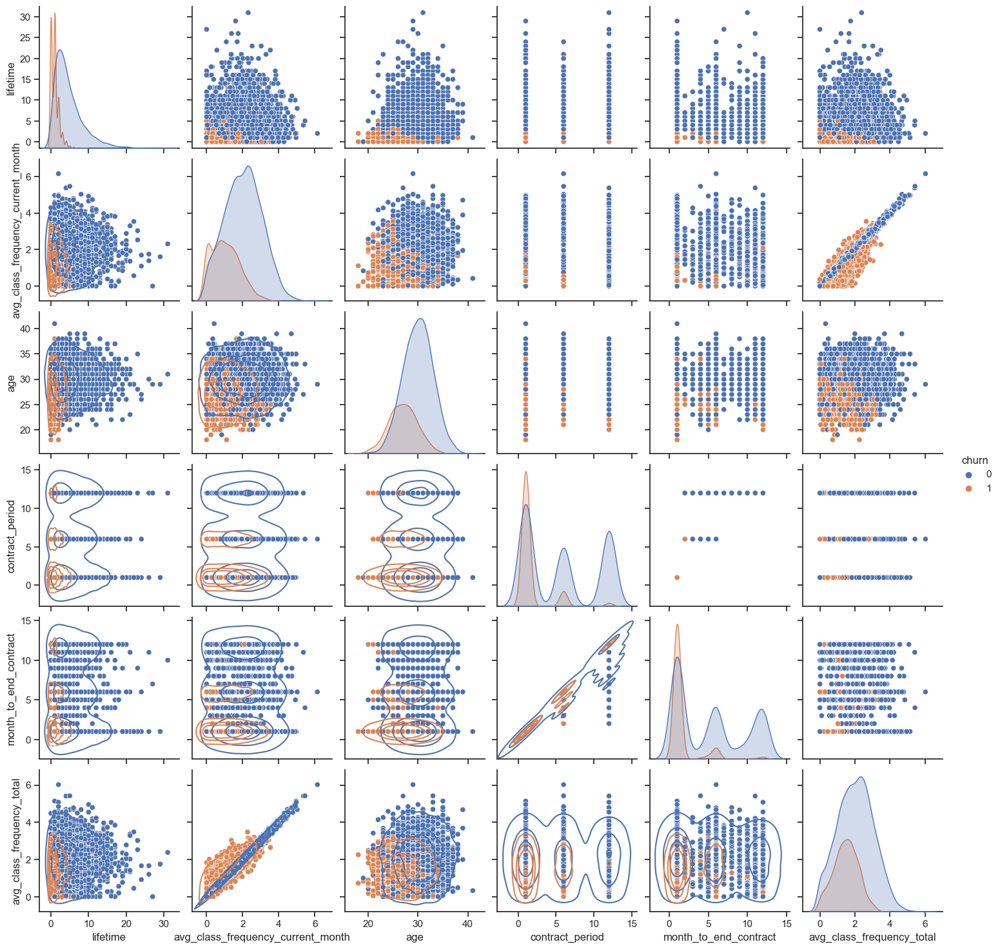

In [24]:
g = sns.pairplot(data[['lifetime', 
                   'avg_class_frequency_current_month',  
                   'age',
                   'contract_period',
                   'month_to_end_contract',
                   'avg_class_frequency_total',
                   'churn']], hue="churn", diag_kind="kde")

g.map_lower(sns.kdeplot, levels=4, color=".2")
plt.show()

Customers who remained with the fitness club tend to have a longer lifetime, higher visit frequency in the past month, are older on average, and hold longer memberships with more time remaining on their contracts.

## Customer Churn Prediction Model

To identify customers at risk of leaving the fitness club, a machine learning model was developed to predict churn based on behavioral, demographic, and contract-related features. The goal was to estimate the probability of churn for each client in order to enable proactive retention strategies.

We will build a binary classification model to predict whether a customer will churn in the following month. The target variable is the churn status (1 – churned, 0 – retained).

### Splitting the Data: Training and Validation Sets Using train_test_split()

We will split the data into training and validation sets using the train_test_split() function. To evaluate model performance effectively, the dataset is split into training and validation subsets using the train_test_split() function from the sklearn.model_selection module. This ensures that the model is trained on one portion of the data and tested on another to assess generalization.

In [25]:
y = data['churn']

In [26]:
X = data.drop('churn', axis = 1)

In [27]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0, stratify=y)

The stratify parameter was used with the target variable to ensure that both the training and validation sets maintain the same class distribution. This helps preserve the proportion of churned and retained customers across the splits. The random_state parameter was also set to ensure reproducibility of the results.

The data has now been successfully split: 20% for training and 80% for validation.

In [28]:
data_y = y.value_counts().to_frame().reset_index()
data_y_test = y_test.value_counts().to_frame().reset_index()
data_y_train = y_train.value_counts().to_frame().reset_index()

### Training the Model on the Training Set Using Two Approaches

To compare performance and choose the best solution for predicting customer churn, we trained two classification models using the training dataset:
* Logistic Regression – a simple, interpretable linear model that works well for binary classification problems.
* Random Forest Classifier – a more complex, ensemble-based model that can capture non-linear relationships and interactions between features.
Each model was trained on the same training data and evaluated using the validation set to compare their accuracy, precision, recall, F1-score, and ROC AUC. This dual-model approach helps us balance performance and interpretability when selecting the final model for deployment.

#### МLogistic Regression Model

Logistic Regression, also known as a logit model, is a statistical model used to predict the probability of a binary outcome by fitting the data to a logistic curve. It estimates the likelihood of an event occurring by producing a probability between 0 and 1. The output is then typically interpreted as a binary classification — for example, 1 for churn and 0 for retention.

Let’s define the algorithm for the logistic regression model:

In [29]:
lr_model = LogisticRegression(solver='liblinear')

Let’s train the model on the training set:

In [30]:
lr_model.fit(X_train, y_train)

LogisticRegression(solver='liblinear')

In [31]:
lr_model.get_params(deep=True)

{'C': 1.0,
 'class_weight': None,
 'dual': False,
 'fit_intercept': True,
 'intercept_scaling': 1,
 'l1_ratio': None,
 'max_iter': 100,
 'multi_class': 'auto',
 'n_jobs': None,
 'penalty': 'l2',
 'random_state': None,
 'solver': 'liblinear',
 'tol': 0.0001,
 'verbose': 0,
 'warm_start': False}

Let’s use the trained model to make predictions:

In [32]:
lr_predictions = lr_model.predict(X_test)
lr_probabilities = lr_model.predict_proba(X_test)[:,1]

Let’s take a closer look at the predictions.

In [33]:
lr_data = X_test.copy()
lr_data['predictions'] = lr_predictions
lr_data['probabilities'] = lr_probabilities
lr_data

,gender,near_location,promo_friends,phone,contract_period,group_visits,age,avg_additional_charges_total,month_to_end_contract,lifetime,avg_class_frequency_total,avg_class_frequency_current_month,predictions,probabilities
3025,0,1,1,1,1,1,27,61.35,1.00,1,1.23,0.81,1,0.88
31,0,1,0,1,12,1,32,87.86,12.00,1,0.00,0.00,0,0.07
2017,1,1,0,1,12,1,25,243.13,12.00,4,1.02,0.94,0,0.01
55,0,1,1,0,1,0,30,194.67,1.00,4,1.89,1.90,0,0.02
2096,1,1,0,1,1,0,32,101.19,1.00,5,1.84,1.80,0,0.03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1224,1,1,0,1,1,1,31,281.63,1.00,0,2.28,2.18,0,0.37
3641,0,1,0,1,1,0,30,136.22,1.00,0,1.42,1.36,1,0.80
2520,1,1,0,1,12,0,30,248.19,12.00,5,1.87,1.83,0,0.00
3395,1,1,0,1,1,0,30,145.57,1.00,3,3.70,3.73,0,0.04


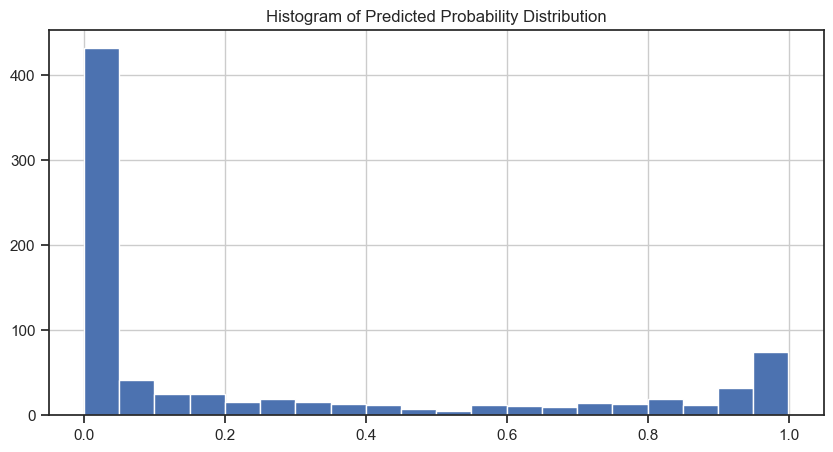

In [34]:
plt.figure(figsize=(10, 5))
lr_data['probabilities'].hist(bins=20)
plt.title('Histogram of Predicted Probability Distribution')
plt.show()

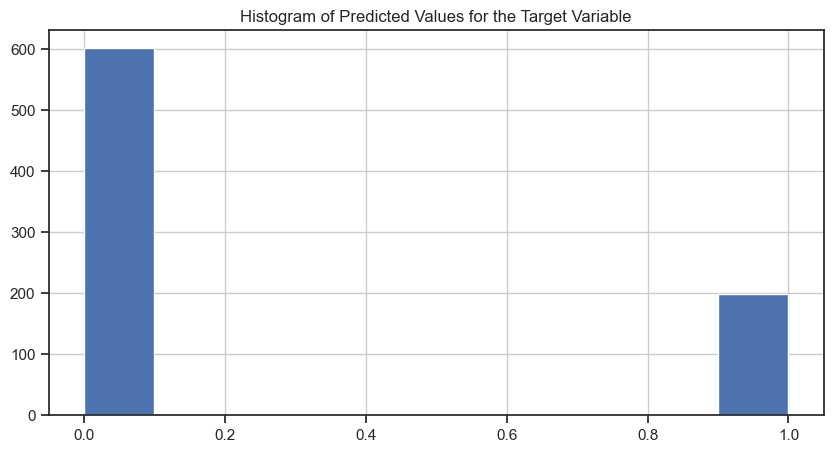

In [35]:
plt.figure(figsize=(10, 5))
lr_data['predictions'].hist()
plt.title('Histogram of Predicted Values for the Target Variable')
plt.show()

The regression relationship can be visualized using Seaborn’s regplot() and lmplot() functions, with the parameter logistic=True to display a logistic regression curve.

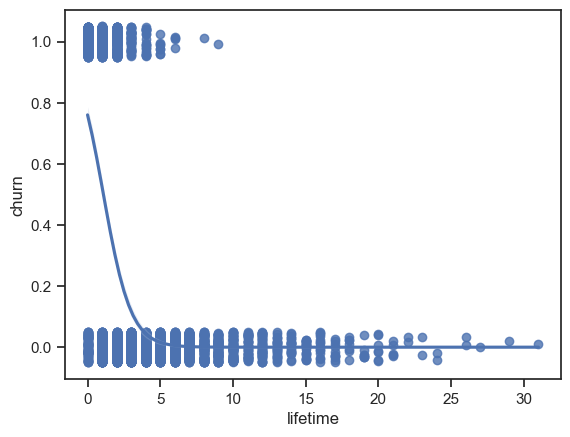

In [36]:
sns.regplot(x="lifetime", 
            y="churn", 
            data=data,
           logistic=True, n_boot=500, y_jitter=.05)
plt.show()

As shown in the plot above, the longer the customer’s lifetime, the lower the likelihood of churn.

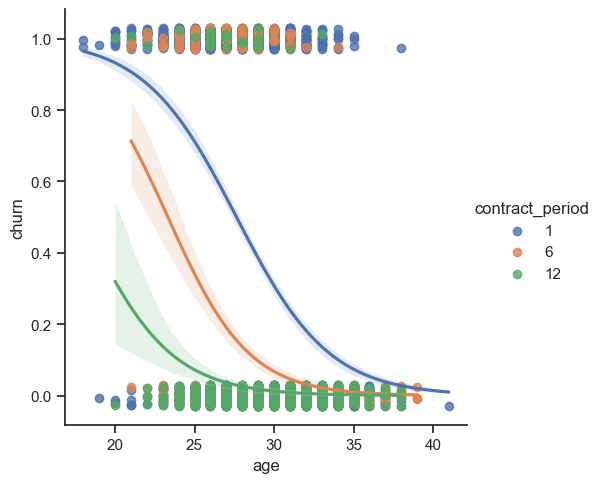

In [37]:
sns.lmplot(y="churn", x="age", hue="contract_period", data=data, 
           logistic=True, n_boot=500, y_jitter=.03)
plt.show()

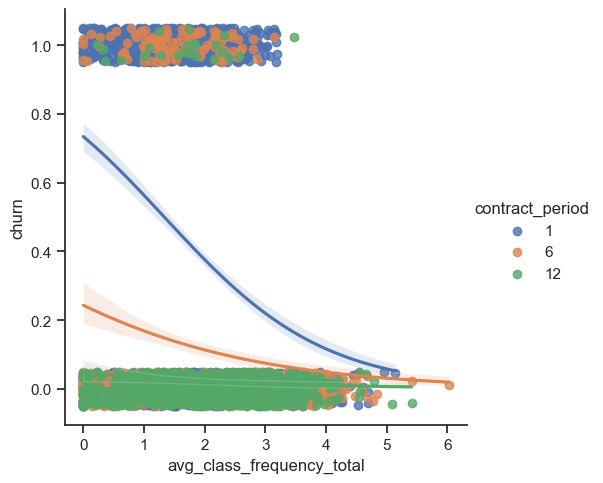

In [38]:
sns.lmplot(y="churn", x="avg_class_frequency_total", hue="contract_period", data=data, 
           logistic=True, n_boot=500, y_jitter=.05)
plt.show()

We can conclude that the higher the visit frequency, the lower the likelihood of churn. In addition, customers with long-term memberships are generally less likely to leave.

The age-related trend shows that older clients are less likely to churn, and a similar pattern is observed with longer membership durations.

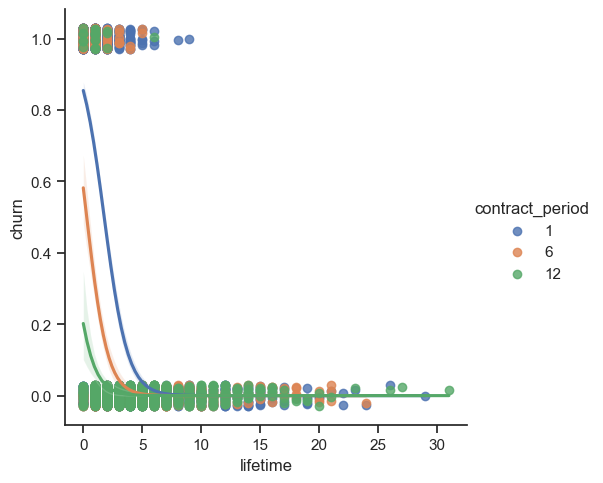

In [39]:
sns.lmplot(y="churn", x="lifetime", data=data, hue='contract_period',
           logistic=True, n_boot=500, y_jitter=.03
          )
plt.show()

In [40]:
lr_model.coef_

array([[ 0.04784733,  0.0938597 , -0.3213478 ,  0.47165011, -0.1930009 ,
        -0.70669926, -0.19640392, -0.00485756, -0.08091826, -0.90791455,
         3.23966627, -3.89102232]])

In [41]:
X_train.columns

Index(['gender', 'near_location', 'promo_friends', 'phone', 'contract_period',
       'group_visits', 'age', 'avg_additional_charges_total',
       'month_to_end_contract', 'lifetime', 'avg_class_frequency_total',
       'avg_class_frequency_current_month'],
      dtype='object')

In [42]:
 lr_model.intercept_

array([8.38792261])

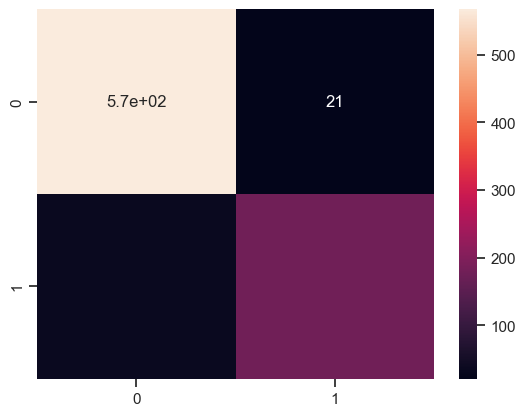

In [43]:
cm = confusion_matrix(y_test, lr_predictions)
sns.heatmap(cm, annot=True)
plt.show()

The logistic regression model has now been successfully built.

#### Random Forest Model

Let’s define a new model using the Random Forest algorithm:

In [44]:
rf_model =  RandomForestClassifier(n_estimators=100, random_state=0)

Let’s train the Random Forest model:

In [45]:
rf_model.fit(X_train, y_train)

RandomForestClassifier(random_state=0)

Let’s use the trained model to make predictions:

In [46]:
rf_predictions = rf_model.predict(X_test)
rf_probabilities = rf_model.predict_proba(X_test)[:, 1]

<Figure size 2500x2000 with 0 Axes>

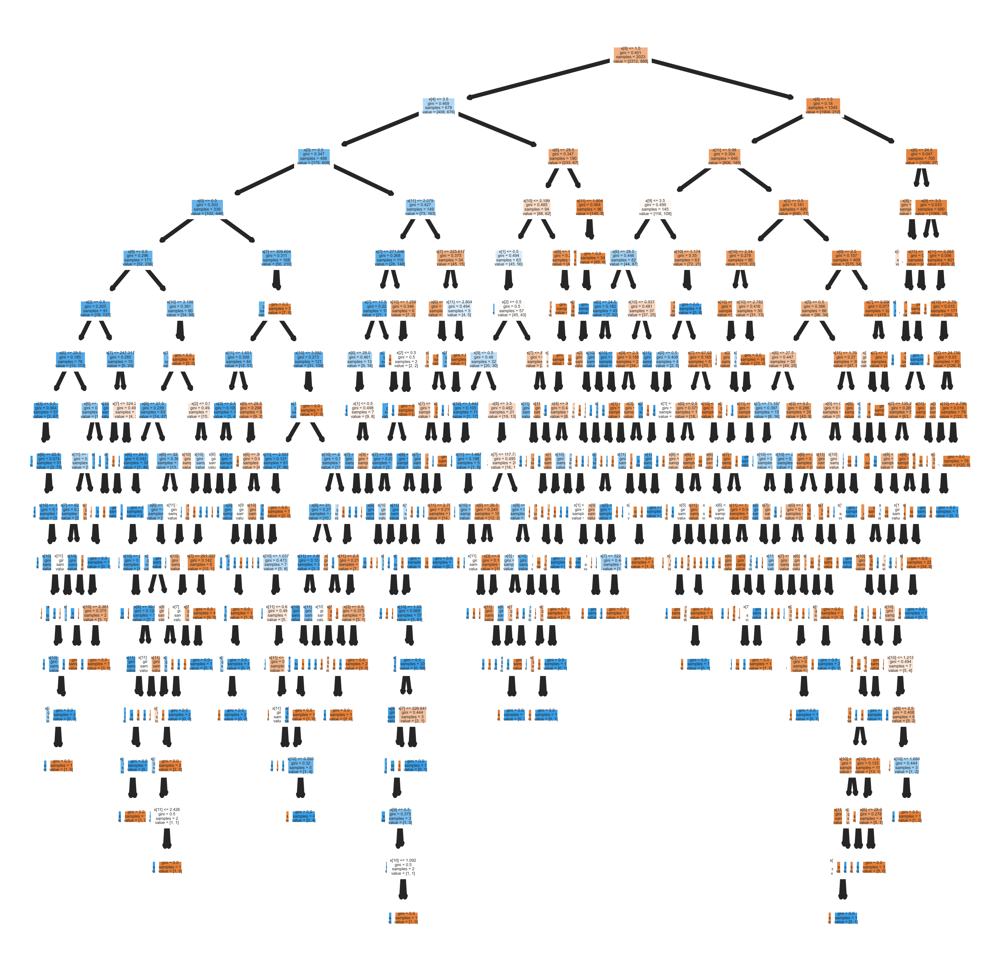

In [47]:
fig = plt.figure(figsize=(25,20))
#fn=data.feature_names
#cn=data.target_names
fig, axes = plt.subplots(nrows = 1,
                         ncols = 1,
                         figsize = (4,4), 
                         dpi=800)

plot_tree(rf_model.estimators_[0],
               #feature_names = fn, 
               #class_names=cn,
               filled = True);

#fig.savefig('rf_individualtree.png')
plt.show()

In [48]:
# This may not the best way to view each estimator as it is small
#fn=data.feature_names
#cn=data.target_names
fig, axes = plt.subplots(nrows = 1,ncols = 4,figsize = (20,10), dpi=900)
for index in range(0, 4):
    plot_tree(rf_model.estimators_[index],
                   #feature_names = fn, 
                   #class_names=cn,
                   filled = True,
                   ax = axes[index]);

    axes[index].set_title('Estimator: ' + str(index), fontsize = 11)
#plt.show()
#fig.savefig('rf_5trees.png')

The Random Forest model has now been successfully built.

### Model Evaluation and Comparison

Let’s define a function to calculate the required evaluation metrics.

In [49]:
def print_all_metrics(y_true, y_pred, y_proba, title='Classification Metrics'):
    print(title)
    print('\tAccuracy: {:.2f}'.format(accuracy_score(y_true, y_pred)))
    print('\tPrecision: {:.2f}'.format(precision_score(y_true, y_pred)))
    print('\tRecall: {:.2f}'.format(recall_score(y_true, y_pred)))
    print('\tF1: {:.2f}'.format(f1_score(y_true, y_pred)))
    print('\tROC_AUC: {:.2f}'.format(roc_auc_score(y_true, y_proba)))

Optimizing the code with functions makes the overall project more readable and easier to maintain.

In [50]:
print_all_metrics(
    y_test,
    lr_predictions,
    lr_probabilities,
    title='Metrics for the Logistic Regression Model:',
)

Metrics for the Logistic Regression Model:
	Accuracy: 0.93
	Precision: 0.89
	Recall: 0.83
	F1: 0.86
	ROC_AUC: 0.98


In [51]:
print_all_metrics(
    y_test,
    rf_predictions,
    rf_probabilities, 
    title='Metrics for the Random Forest Model:'
)

Metrics for the Random Forest Model:
	Accuracy: 0.92
	Precision: 0.89
	Recall: 0.81
	F1: 0.85
	ROC_AUC: 0.97


The evaluation of the metrics showed that the logistic regression model performed slightly better overall. It achieved higher scores in key metrics such as Precision, Recall, and F1-score.

Let’s visualize the ROC metric by plotting the ROC curve:

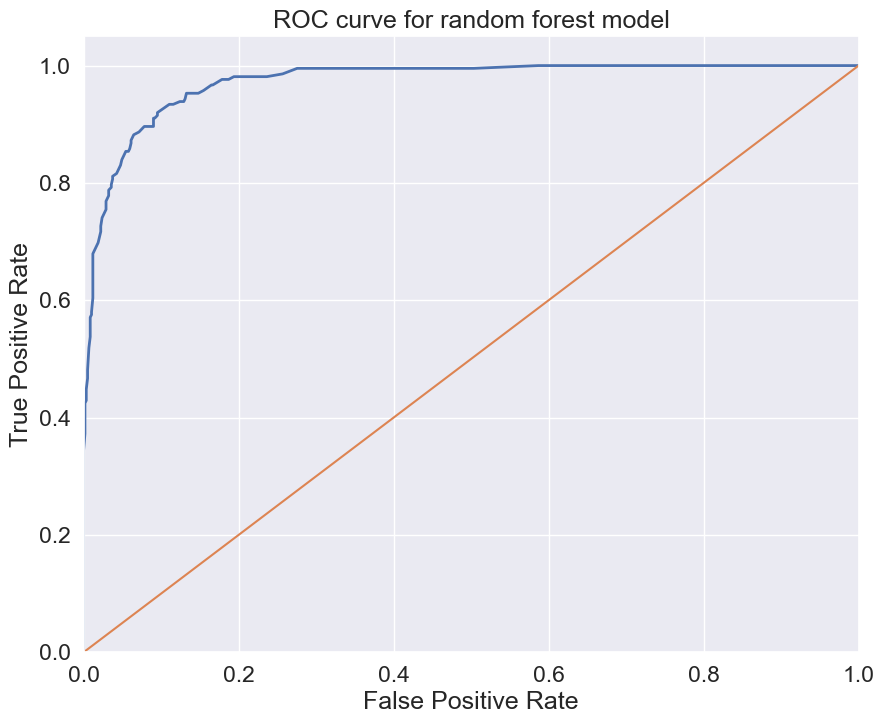

In [52]:
sns.set(font_scale=1.5)
sns.set_color_codes("muted")

plt.figure(figsize=(10, 8))
fpr, tpr, thresholds = roc_curve(y_test, rf_model.predict_proba(X_test)[:,1], pos_label=1)
lw = 2
plt.plot(fpr, tpr, lw=lw, label='ROC curve ')
plt.plot([0, 1], [0, 1])
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curve for random forest model')
plt.savefig("ROC.png")
plt.show()

The function logloss_crutch calculates the log loss for a single prediction. Log loss penalizes incorrect predictions with high confidence more heavily than those with low confidence.

In [53]:
def logloss_crutch(y_true, y_pred, eps=1e-15):

    return - (y_true * np.log(y_pred) + (1 - y_true) * np.log(1 - y_pred))

print('Logloss при неуверенной классификации %f' % logloss_crutch(1, 0.5))
#>> Logloss при неуверенной классификации 0.693147

print('Logloss при уверенной классификации и верном ответе %f' % logloss_crutch(1, 0.9))
#>> Logloss при уверенной классификации и верном ответе 0.105361

print('Logloss при уверенной классификации и НЕверном ответе %f' % logloss_crutch(1, 0.1))
#>> Logloss при уверенной классификации и НЕверном ответе 2.302585

Logloss при неуверенной классификации 0.693147
Logloss при уверенной классификации и верном ответе 0.105361
Logloss при уверенной классификации и НЕверном ответе 2.302585


In [54]:
print('Log loss for an uncertain classification: %f' % logloss_crutch(1, 0.5))
# Output: 0.693147

print('Log loss for a confident and correct classification: %f' % logloss_crutch(1, 0.9))
# Output: 0.105361

print('Log loss for a confident but incorrect classification: %f' % logloss_crutch(1, 0.1))
# Output: 2.302585

Log loss for an uncertain classification: 0.693147
Log loss for a confident and correct classification: 0.105361
Log loss for a confident but incorrect classification: 2.302585


🔚 **Conclusion**

These results illustrate how log loss penalizes prediction errors based on their confidence.
 
* An uncertain prediction (0.5) leads to a moderate penalty (0.693147).

* A confident and correct prediction (0.9) yields a low log loss (0.105361).

* A confident but incorrect prediction (0.1) incurs a severe penalty (2.302585).

📌 **Why It Matters in This Project**

In churn prediction, we don’t just want to classify customers as likely to leave or stay, we want to estimate the probability of churn accurately.
Log loss rewards models that output well-calibrated probabilities, which is critical for:

* **Targeting**. Knowing how likely someone is to churn helps prioritize retention efforts and allocate resources efficiently.

* **Personalization**. A customer with a 90% churn probability may need a stronger incentive than one at 60%.

* **Business decisions**. Accurate probabilities drive smarter, cost-effective interventions rather than one-size-fits-all solutions.

Thus, log loss helps ensure our model not only classifies correctly but also supports informed, data-driven actions.

## Customer Clustering

### Data Standardization

Before performing clustering, it is essential to standardize the data to ensure that all features contribute equally to distance-based algorithms such as K-Means.

First, we create a Scaler object (a normalization tool), then fit it to the data and transform the dataset accordingly.

In [55]:
scaler = StandardScaler()
X_sc = scaler.fit_transform(data.drop(columns = ['churn']))

In [56]:
X_sc[:2]

array([[ 0.97970588,  0.42788074,  1.49716101, -3.05985201,  0.28989014,
         1.19403206, -0.0565538 , -1.37753121,  0.16160501, -0.19332863,
        -1.91191971, -1.67847198],
       [-1.0207145 ,  0.42788074, -0.66793083,  0.32681319,  1.60882159,
         1.19403206,  0.55732732, -0.35021325,  1.83194105,  0.87368001,
         0.04517569,  0.1360137 ]])

After the transformation, we obtained standardized feature values, which will be used for the clustering process.

### Agglomerative Hierarchical Clustering

We will now apply agglomerative hierarchical clustering using the standardized data. The standardized table is passed as input to the linkage() function. To calculate the distance between clusters, we use the Ward method, which minimizes the variance within clusters during the merging process.

In [57]:
linked = linkage(X_sc, method = 'ward') 

The *linked* variable stores the linkage matrix between objects. It can be visualized as a **dendrogram**:

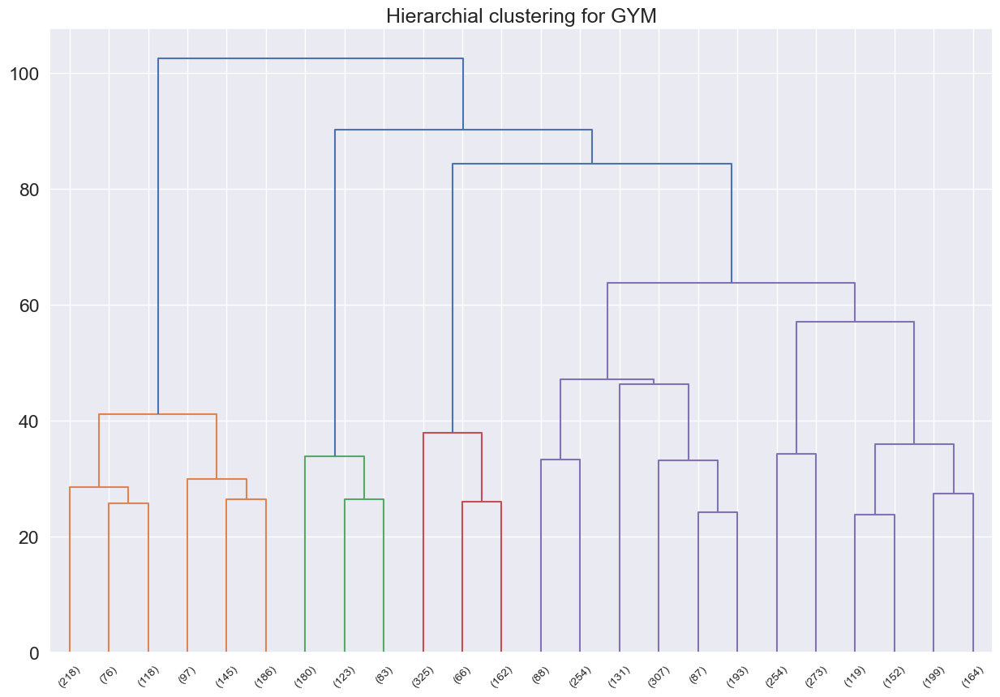

In [58]:
plt.figure(figsize=(15, 10))  
dendrogram(linked, orientation='top', truncate_mode = 'lastp', p = 24, leaf_rotation = 45)
plt.title('Hierarchial clustering for GYM')
plt.show() 

The dendrogram displays four distinct color-coded branches, which suggests that the data could potentially be divided into four clusters. However, it's also possible to explore other clustering options depending on the desired level of granularity. 

To determine the optimal number of clusters, one commonly used approach is the elbow method, which evaluates the trade-off between the number of clusters and the within-cluster variance.

Additionally, the Bayesian Information Criterion (BIC) was used below as another statistical method to assess and validate the optimal number of clusters.

In [59]:
scaler = MinMaxScaler()
X_scaled=scaler.fit_transform(X)

In [60]:
gm_bic= []
gm_score=[]
for i in range(2,12):
    gm = GaussianMixture(n_components=i,n_init=10,tol=1e-3,max_iter=1000).fit(X_sc)
    print("BIC for number of cluster(s) {}: {}".format(i,gm.bic(X_scaled)))
    print("Log-likelihood score for number of cluster(s) {}: {}".format(i,gm.score(X_sc)))
    print("-"*100)
    gm_bic.append(-gm.bic(X_sc))
    gm_score.append(gm.score(X_sc))

BIC for number of cluster(s) 2: 106478.85980686138
Log-likelihood score for number of cluster(s) 2: -9.780713417515774
----------------------------------------------------------------------------------------------------
BIC for number of cluster(s) 3: 1679069851.2343247
Log-likelihood score for number of cluster(s) 3: -3.084282775730199
----------------------------------------------------------------------------------------------------
BIC for number of cluster(s) 4: 1679070050.8425643
Log-likelihood score for number of cluster(s) 4: 0.47433648251961186
----------------------------------------------------------------------------------------------------
BIC for number of cluster(s) 5: 2899020535.3968654
Log-likelihood score for number of cluster(s) 5: 3.6830519148561285
----------------------------------------------------------------------------------------------------
BIC for number of cluster(s) 6: 4400079993.276031
Log-likelihood score for number of cluster(s) 6: 6.948397807340453
--

The **Bayesian Information Criterion (BIC)** penalizes overly complex models with too many Gaussian components, aiming to keep the model as simple as possible while still capturing the underlying pattern.

As a result, when applying the **Gaussian Mixture Model (GMM)** with an increasing number of cluster centers, the BIC value typically decreases up to a certain point, after which it **starts to increase** due to the complexity penalty. The optimal number of clusters is generally found at the **lowest BIC value**, where the balance between model fit and simplicity is best achieved.

C:\Users\Diana\AppData\Local\Temp\ipykernel_19396\305969576.py:3: RuntimeWarning: invalid value encountered in log
  plt.scatter(x=[i for i in range(2,12)],y=np.log(gm_bic),s=150,edgecolor='k')


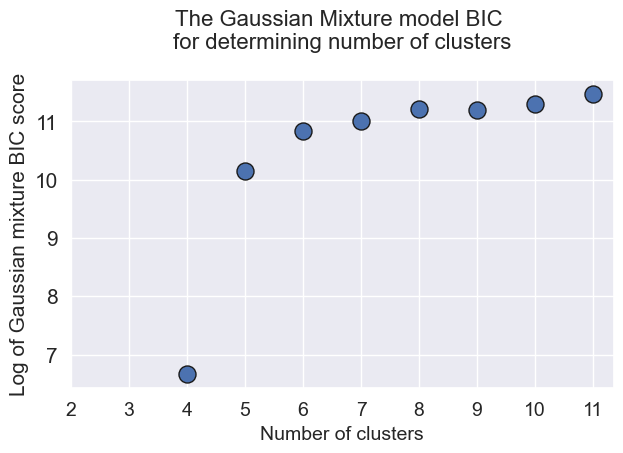

In [61]:
plt.figure(figsize=(7,4))
plt.title("The Gaussian Mixture model BIC \nfor determining number of clusters\n",fontsize=16)
plt.scatter(x=[i for i in range(2,12)],y=np.log(gm_bic),s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("Number of clusters",fontsize=14)
plt.ylabel("Log of Gaussian mixture BIC score",fontsize=15)
plt.xticks([i for i in range(2,12)],fontsize=14)
plt.yticks(fontsize=15)
plt.show()

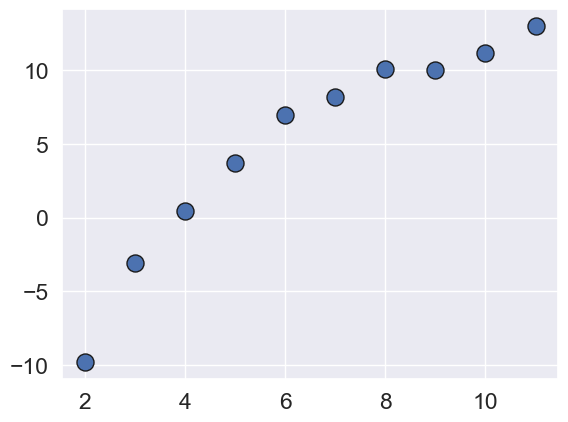

In [62]:
plt.scatter(x=[i for i in range(2,12)],y=gm_score,s=150,edgecolor='k')
plt.show()

A sharp drop up to 5–6 clusters suggests that this is the most reasonable number of clusters in our data.

### Training a Clustering Model Using the K-Means Algorithm and Predicting Customer Clusters

We will set the number of clusters to 5 and fix the random_state parameter to ensure reproducibility. Then, we will apply the K-Means algorithm to the data and generate the cluster labels.



In [63]:
km = KMeans(n_clusters=5, random_state=0)
labels = km.fit_predict(X_sc)

In [64]:
data_cluster = data.copy()

In [65]:
data_cluster['cluster'] = labels
data_cluster.head()

,gender,near_location,promo_friends,phone,contract_period,group_visits,age,avg_additional_charges_total,month_to_end_contract,lifetime,avg_class_frequency_total,avg_class_frequency_current_month,churn,cluster
0,1,1,1,0,6,1,29,14.23,5.00,3,0.02,0.00,0,3
1,0,1,0,1,12,1,31,113.20,12.00,7,1.92,1.91,0,2
2,0,1,0,1,1,0,28,129.45,1.00,2,1.86,1.74,0,4
3,0,1,1,1,12,1,33,62.67,12.00,2,3.21,3.36,0,2
4,1,1,1,1,1,0,26,198.36,1.00,3,1.11,1.12,0,0


In [66]:
clusters = data_cluster.groupby(['cluster']).mean()
clusters.T

cluster,0,1,2,3,4
gender,1.00,0.58,0.49,0.52,0.00
near_location,0.78,0.86,0.94,0.86,0.79
promo_friends,0.23,0.25,0.53,0.31,0.21
phone,1.00,1.00,1.00,0.00,1.00
contract_period,2.10,2.78,11.34,4.79,2.04
group_visits,0.32,0.45,0.56,0.43,0.30
age,28.18,30.29,29.91,29.30,28.35
avg_additional_charges_total,130.67,164.80,163.60,143.96,130.51
month_to_end_contract,1.99,2.56,10.37,4.48,1.92
lifetime,2.48,4.90,4.89,3.92,2.58


We now have clear customer profiles for each cluster.

It’s immediately evident that Cluster 0 includes only male clients, while Cluster 4 is composed entirely of female clients. Cluster 3 is notable for including customers who did not provide a phone number, with a churn rate of 27%. The longest membership durations are observed in Cluster 2, which also shows higher additional revenue, greater visit frequency, more months remaining on active contracts, and the lowest churn rate.

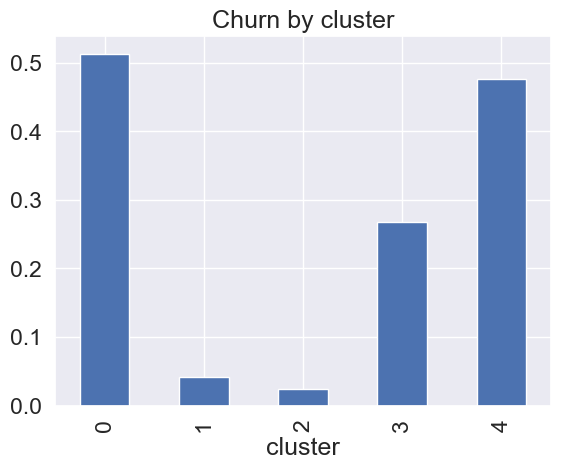

In [67]:
clusters['churn'].plot(kind='bar')
plt.title("Churn by cluster")
plt.show()

In [68]:
def plot_dist_cluster(column):
    ax = sns.displot(data=data_cluster,
                     x=column, 
                     kind="kde", 
                     height=6,
                     aspect=2,
                     hue="cluster",
                     #multiple="stack",
                     fill = True
                    )

    plt.title(f"Distribution histogram of {column.name}")
   
    plt.show()

C:\Users\Diana\AppData\Local\Temp\ipykernel_19396\3334938460.py:2: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  ax = sns.displot(data=data_cluster,


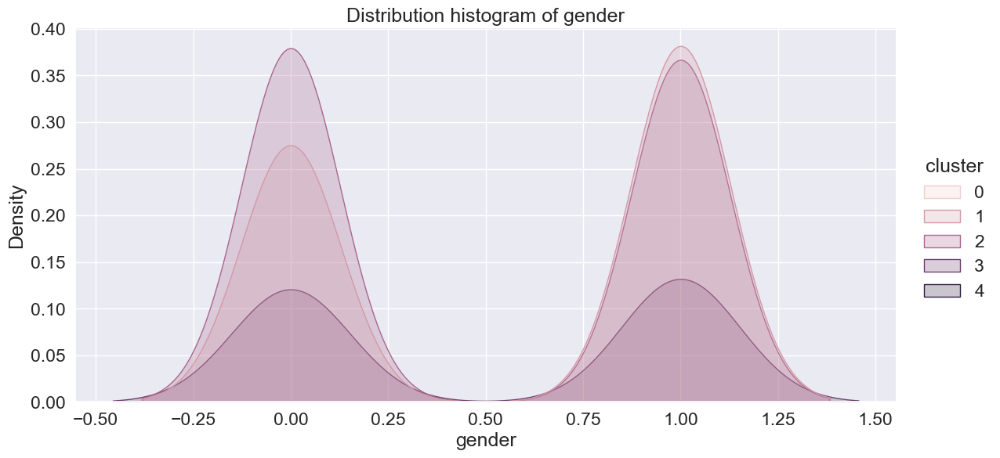

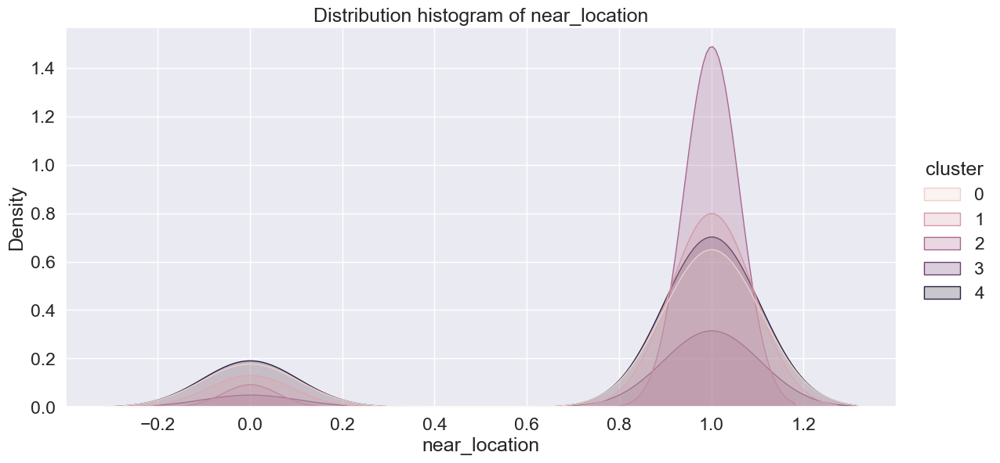

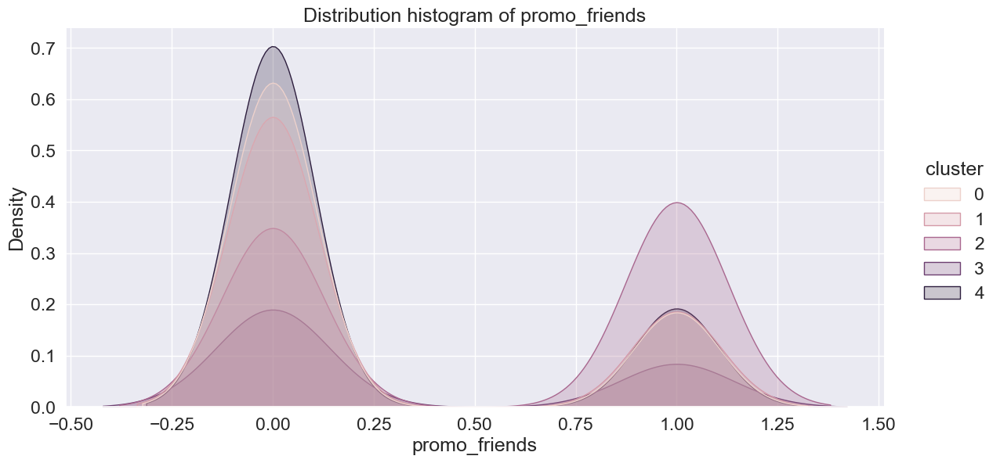

C:\Users\Diana\AppData\Local\Temp\ipykernel_19396\3334938460.py:2: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  ax = sns.displot(data=data_cluster,


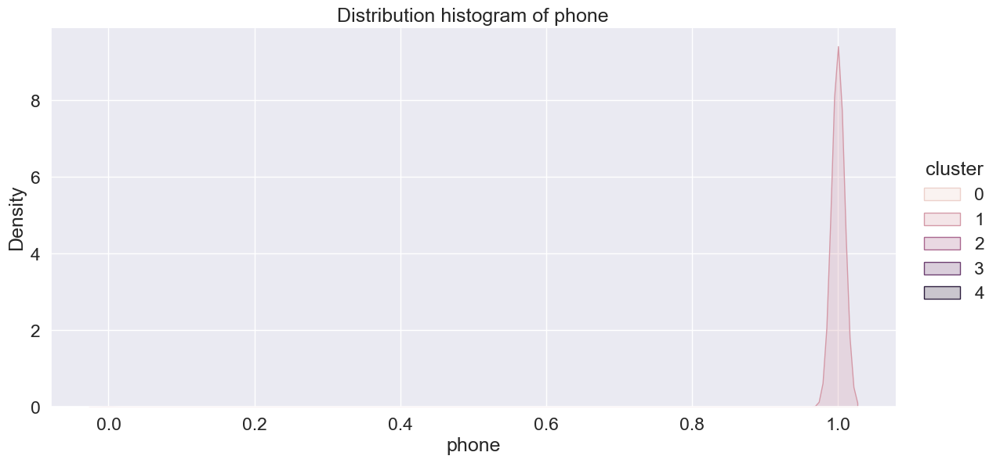

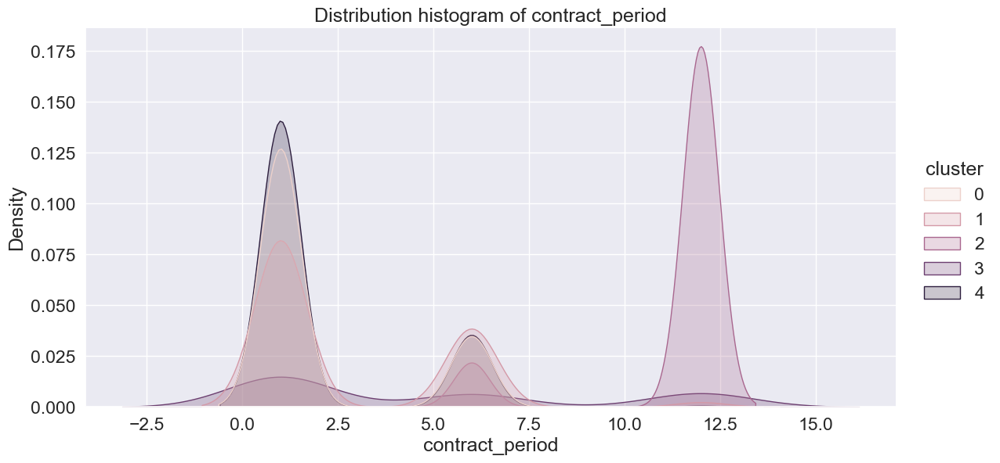

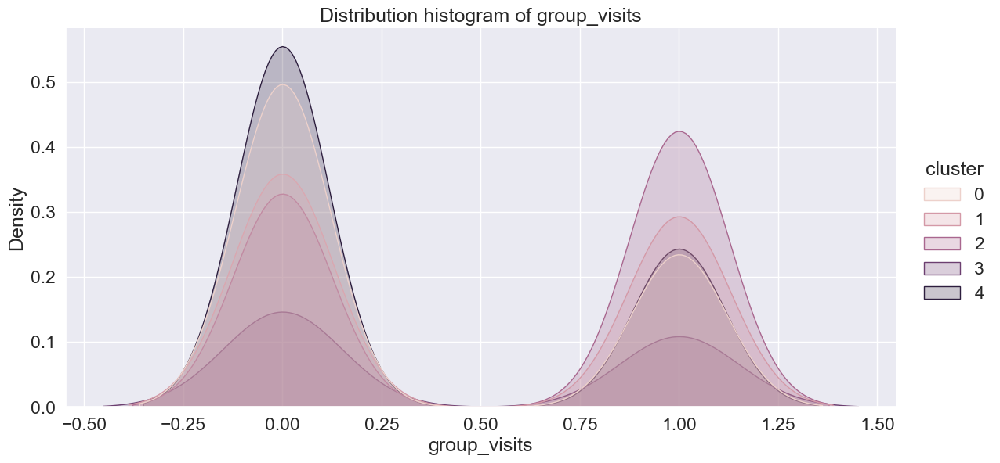

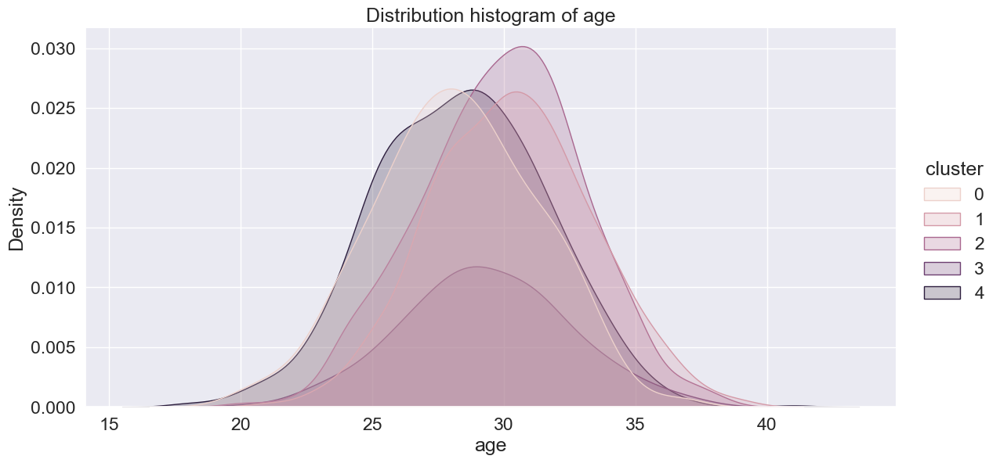

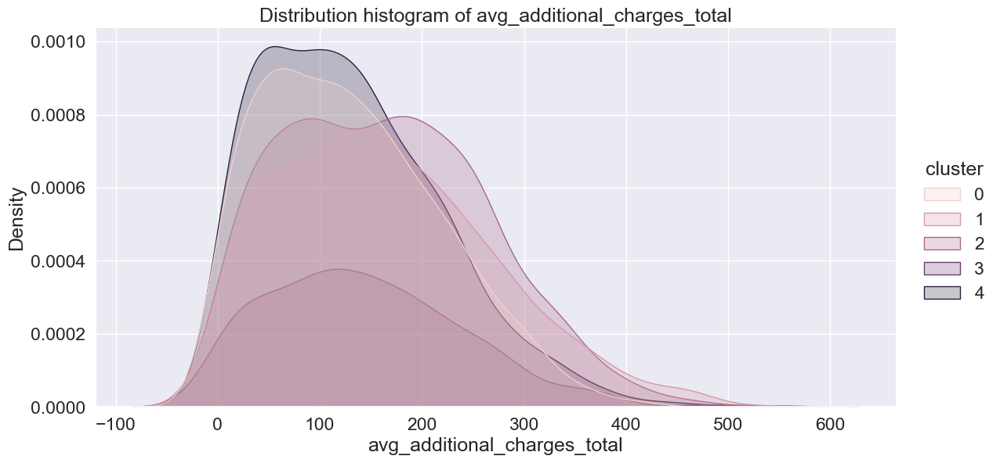

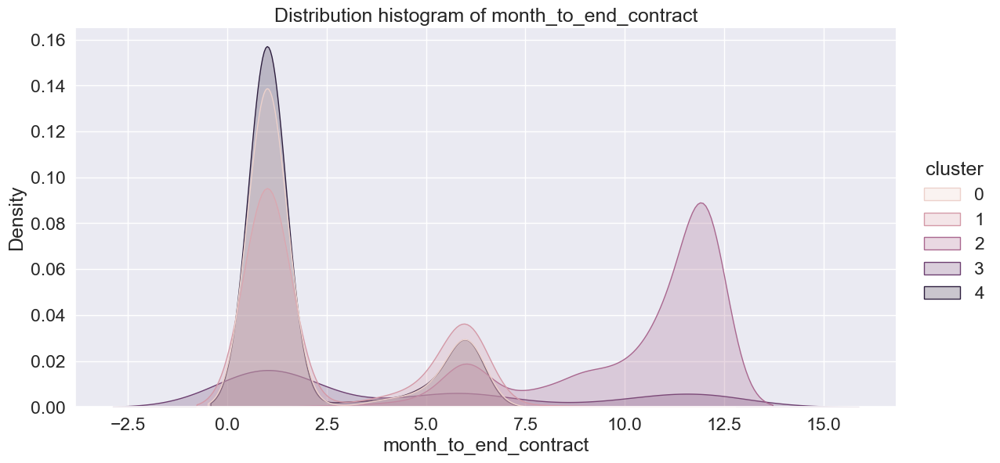

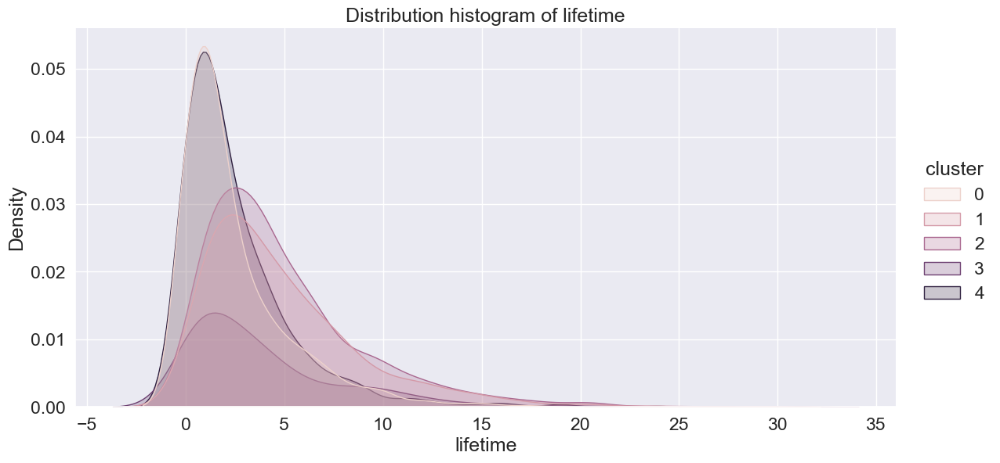

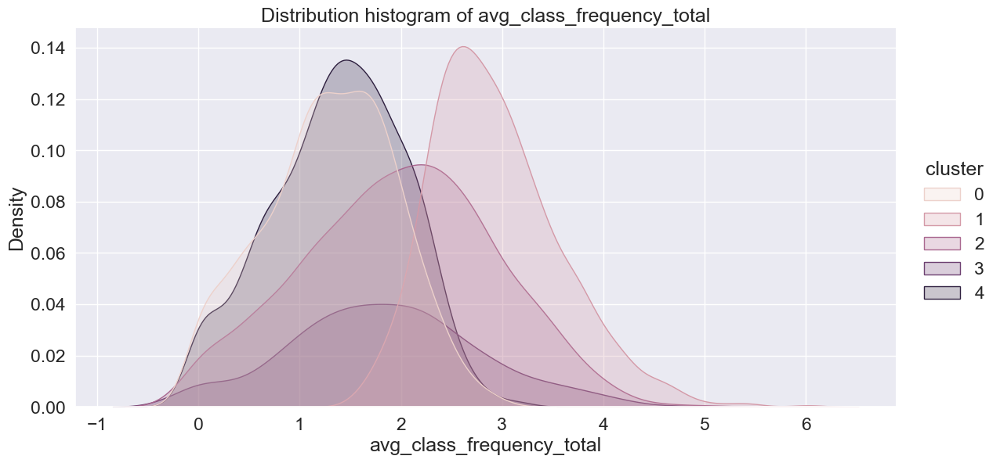

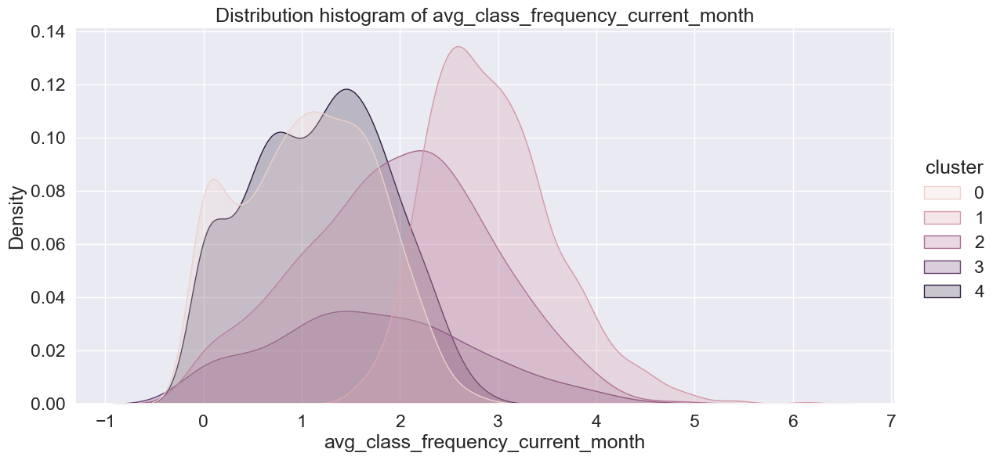

In [69]:
for col in data.columns[:-1]:
    plot_dist_cluster(data[col])

Let’s define a function to plot pairwise feature relationships for the clusters.

In [70]:
def show_clusters_on_plot(df, x_name,y_name, cluster_name):
    plt.figure(figsize = (5,5))
    sns.scatterplot(x=df[x_name], y=df[y_name],
           hue=df[cluster_name], palette='Paired'
       )
    plt.title('{} vs {}'.format(x_name, y_name))
    plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
    plt.show()

Let’s plot the pairwise feature combinations with cluster labels.

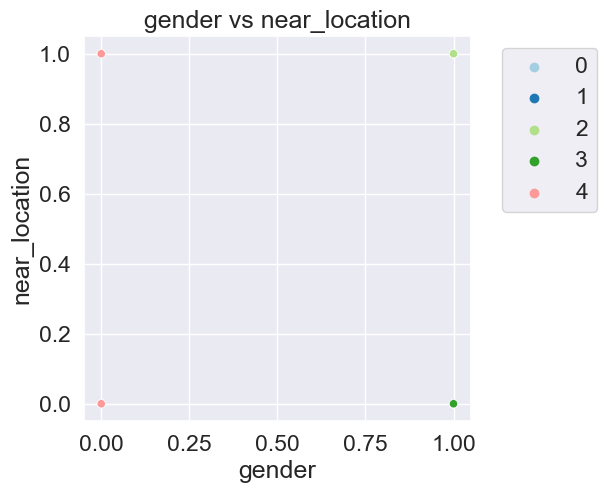

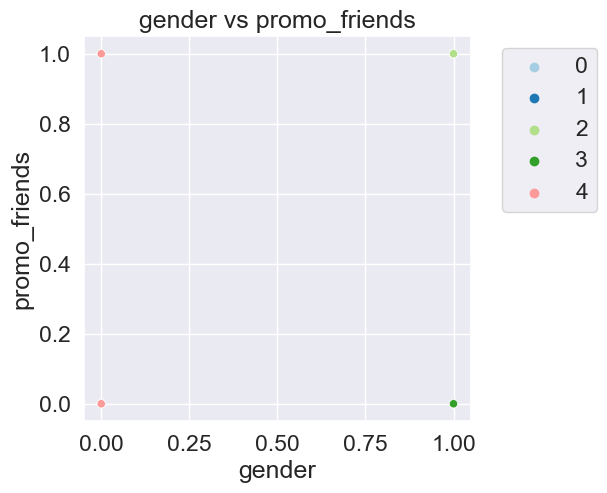

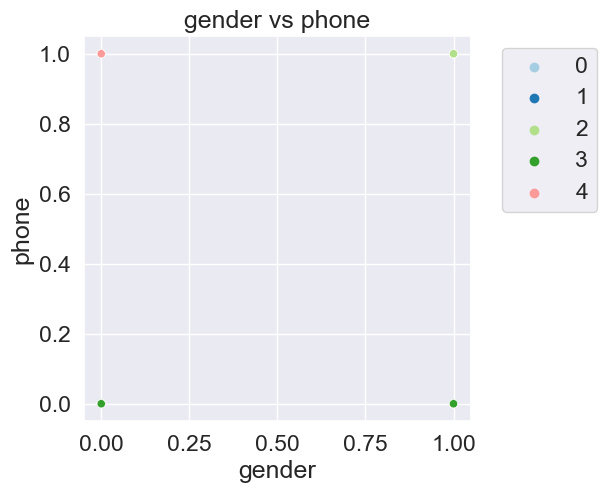

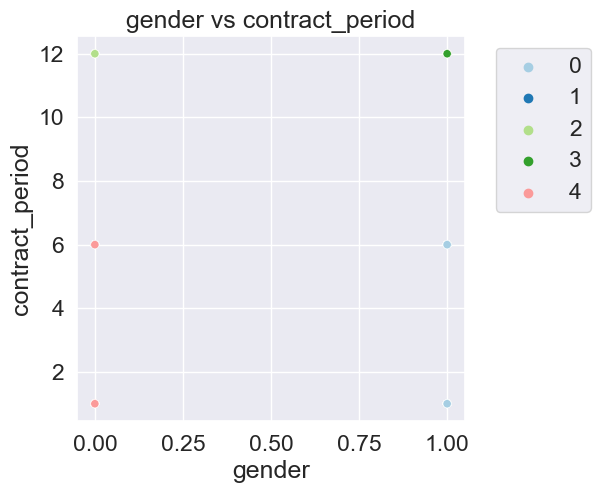

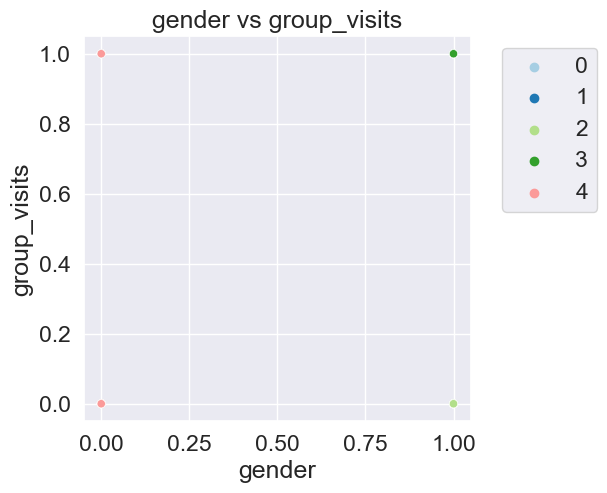

...

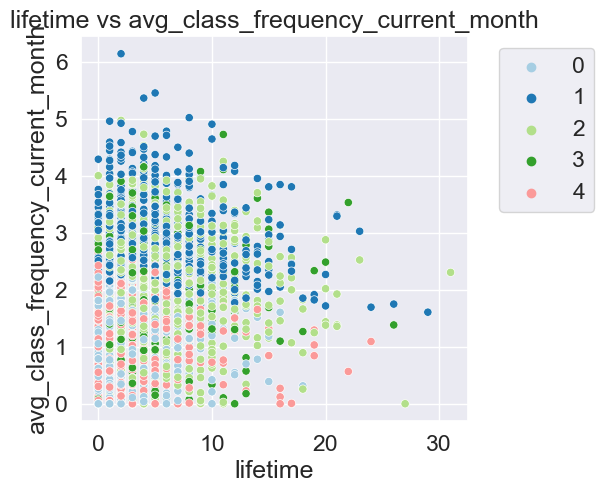

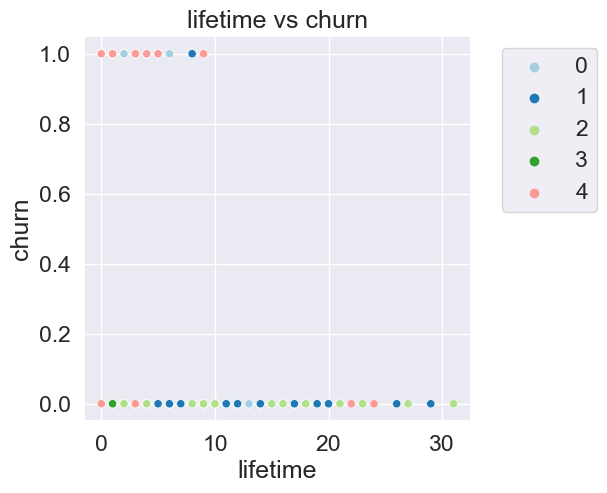

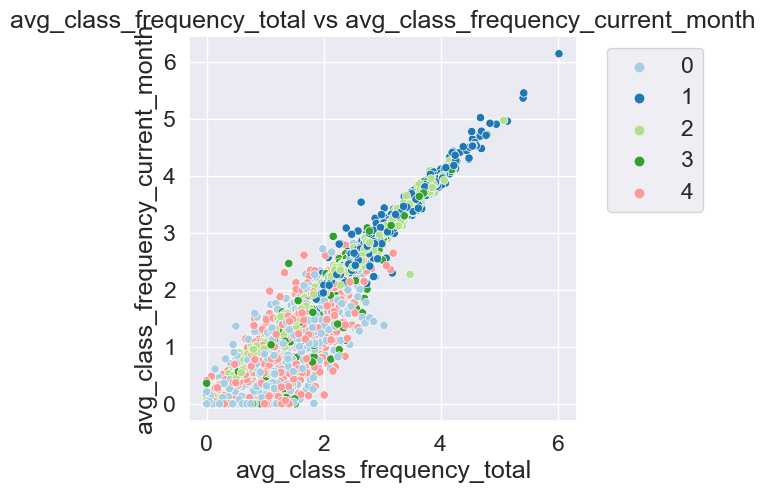

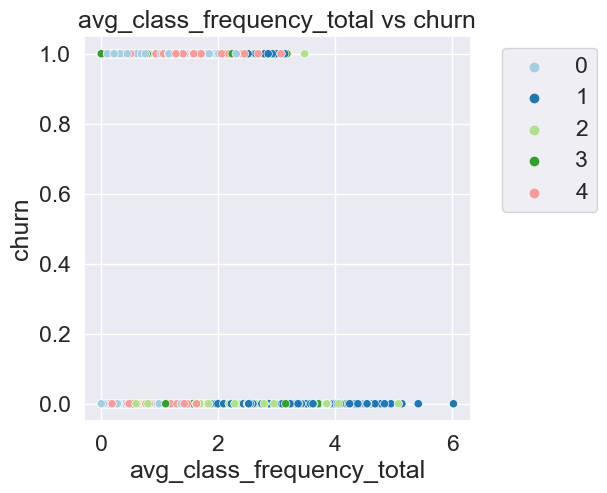

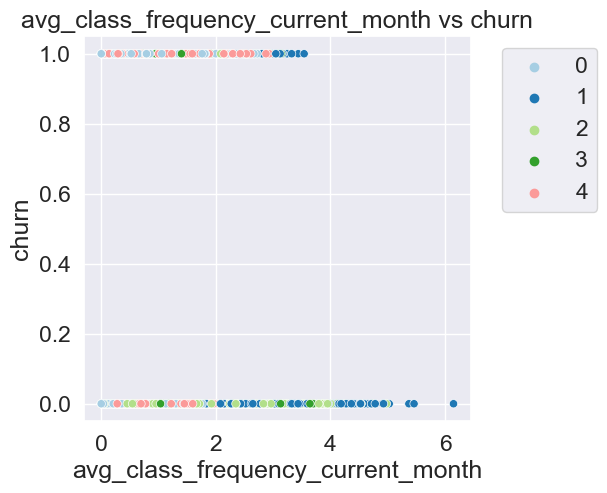

In [71]:
col_pairs = list(itertools.combinations(data_cluster.drop('cluster', axis=1).columns, 2))
for pair in col_pairs:
    show_clusters_on_plot(data_cluster, pair[0], pair[1], 'cluster')

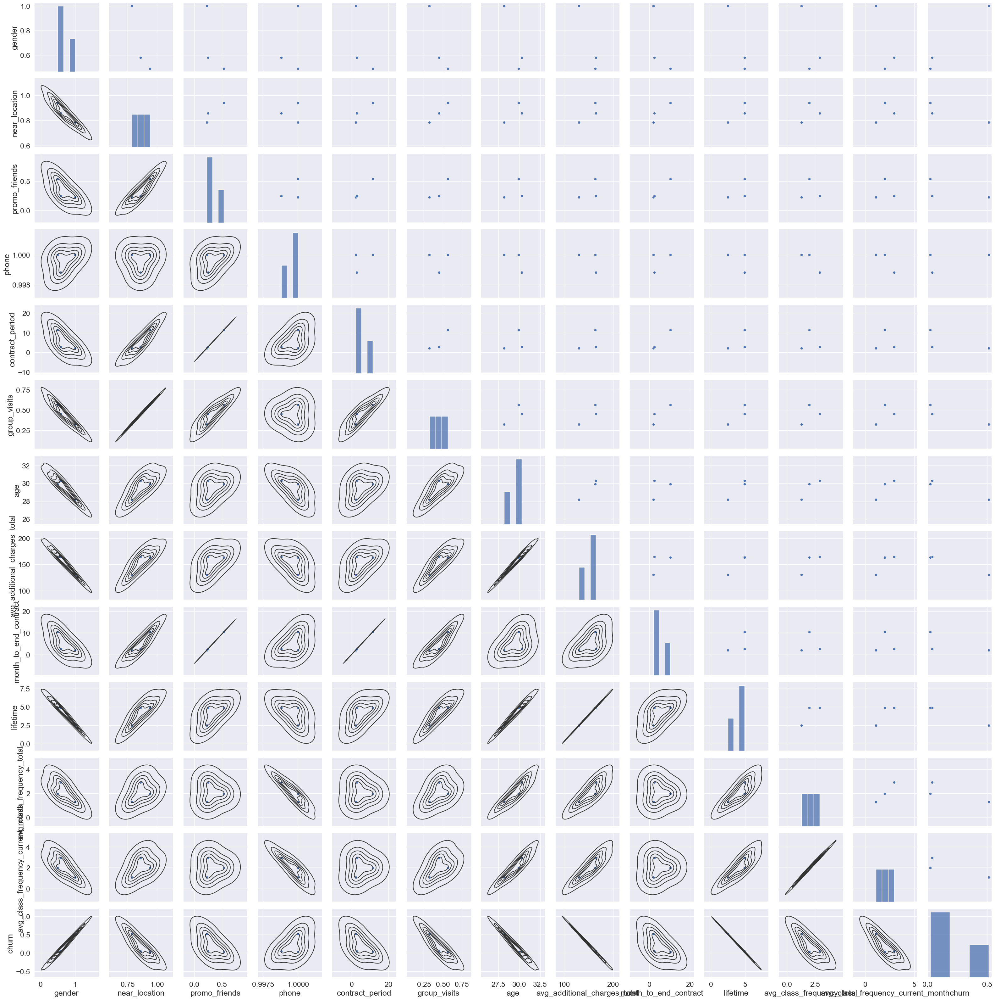

In [72]:
g = sns.pairplot(clusters[:3])
g.map_lower(sns.kdeplot, levels=6, color=".2")
plt.show()

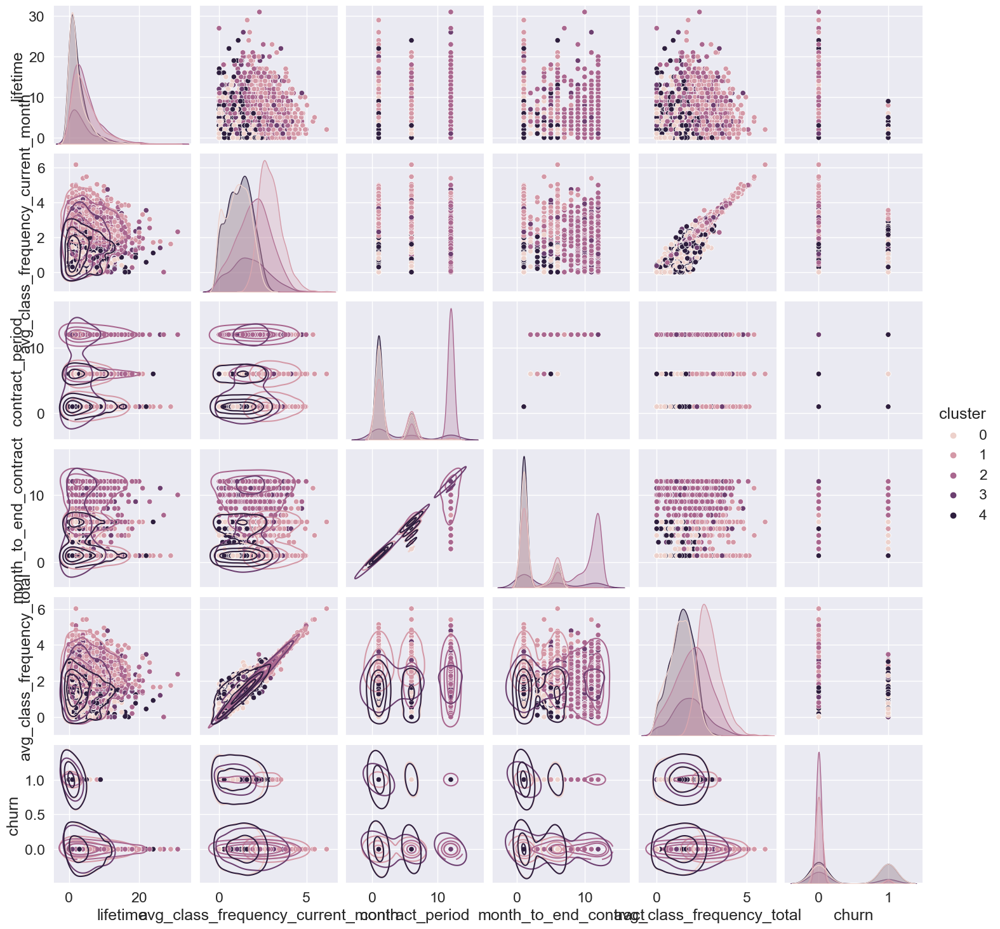

In [73]:
g = sns.pairplot(data_cluster[['lifetime', 
                   'avg_class_frequency_current_month',  
                       
                   'cluster',
                       
                   'contract_period',
                   'month_to_end_contract',
                   'avg_class_frequency_total',
                       
                   'churn']], 
                 
                 hue="cluster", diag_kind="kde")

g.map_lower(sns.kdeplot, levels=4, color=".2")
plt.show()

**🔍 Cluster Structure and Behavioral Patterns**

1. **Clusters are well-separated** across several dimensions, especially:
   - `lifetime`  
   - `avg_class_frequency_current_month`  
   - `avg_class_frequency_total`  
   - `contract_period` and `month_to_end_contract`  
   This indicates that the clustering algorithm successfully captured meaningful behavioral differences.

2. **Churn Patterns Across Clusters:**
   - Some clusters (e.g., Cluster 3 and 4) are visibly associated with higher churn rates, as seen in the bottom row (`churn` feature).
   - Other clusters (e.g., Cluster 1 and 2) show tight groupings near `churn = 0`, suggesting higher retention.

3. **Engagement-Related Features:**
   - There is a strong positive correlation between `avg_class_frequency_current_month`, `avg_class_frequency_total`, and `lifetime`.  
     → Customers who have been members longer also tend to visit more regularly.
   - Clusters with low visit frequency and short `lifetime` are more prone to churn.

4. **Contract Terms Influence Behavior:**
   - Clients in clusters with longer `contract_period` and higher `month_to_end_contract` values generally show lower churn tendencies.
   - These customers are also more likely to have higher engagement levels (more frequent visits).

**✅ Overall Insights**

- Cluster separation appears to reflect meaningful customer segments.
- Features like **lifetime**, **visit frequency**, and **contract duration** are strong indicators of churn behavior.
- This segmentation can be used to **target high-risk clusters** with retention strategies and **reinforce loyalty** in low-risk groups.


The clustering analysis revealed five distinct customer segments, each with unique characteristics and churn behavior:

**Cluster 0**
* This segment has the highest churn rate at 52%. It consists exclusively of male customers who live or work near the fitness center, but tend to purchase short-term memberships. Their overall visit frequency is low, both over the entire membership period and in the past month.

**Cluster 1**
* Churn in this group is very low at just 4%. Gender is evenly distributed, and customers typically live or work nearby. This group shows the highest visit frequency, averaging 2.94 visits per week, and also generates the highest revenue from additional services. Their average membership duration is 2.78 months, meaning they prefer shorter, more flexible plans despite high engagement.

**Cluster 2**
* With a churn rate of only 2%, this is the most loyal segment. It includes the highest proportion of customers who joined via the "Bring a Friend" promotion, and 78% are employees of partner companies. These customers hold the longest memberships (12 months) and have the highest participation in group classes.

**Cluster 3**
* This group has a moderate churn rate of 27%. Many customers in this cluster did not provide a phone number, possibly indicating privacy concerns. Their average membership duration is 4.79 months, with a lifetime of 3.92 months. Engagement levels are average across all key metrics.

**Cluster 4**
* The churn rate here is 48%, and this cluster includes only female customers. Like Cluster 0, these clients live near the fitness center and prefer short-term contracts. Behaviorally, they are very similar to Cluster 0, with gender being the primary distinguishing factor.

These insights offer the marketing team valuable, data-driven profiles that can be used to tailor retention strategies. Each cluster presents opportunities for targeted communication, customized offers, and program adjustments aimed at reducing churn and increasing customer loyalty.

## Conclusions and Recommendations

This research explored the factors contributing to customer churn in a fitness club setting. The analysis identified several key drivers of churn, such as membership duration, visit frequency, customer lifetime, and engagement with additional services. Predictive models were built using logistic regression and random forest algorithms, with logistic regression ultimately delivering better performance.

Customer segmentation using clustering revealed five distinct client groups, each with different characteristics and needs:

* Clusters 0 and 4 shared similar behavioral patterns but differed by gender. These segments could benefit from gender-specific marketing campaigns—for example, promoting women’s fitness classes or men’s martial arts programs to better align with their interests.

* Cluster 2 showed the lowest churn rate. This group mainly includes clients who joined through the "Bring a Friend" promotion and purchased long-term memberships. Their loyalty can be maintained by regularly monitoring satisfaction levels (e.g., through surveys), offering loyalty discounts, and introducing new group programs to keep them engaged.

* Cluster 1 also had a low churn rate. These customers are highly engaged gym-goers who prefer individual workouts over group classes. Personalized training options and additional services—such as health screenings, body composition analysis, or even amenities like tanning—could help further increase their satisfaction and retention.

* Cluster 3 displayed average churn rates and includes clients with medium-length memberships and generally average engagement levels. Notably, this group often does not provide a phone number, which may indicate lower trust or a preference for privacy. Rather than using broad promotional campaigns, this group would likely respond better to a more personal, trust-building approach that avoids aggressive marketing.

Overall, the combination of predictive modeling and customer segmentation provides a strong foundation for reducing churn. By aligning communication, services, and offers with the specific needs of each segment, the fitness club can enhance customer satisfaction and improve long-term retention.